# Creating Mountain Landscapes with Deep Convolutional Generative Adversarial Networks

## 1. Load Data

In [1]:
import tensorflow as tf
import os
import sys
import numpy as np
np.set_printoptions(threshold=sys.maxsize)

import pandas as pd
from tensorflow.keras.preprocessing.image import load_img
import pathlib
import glob
from PIL import Image
from skimage.transform import resize
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import time
from IPython import display

In [2]:
BASE_PATH = '/notebooks/storage/abstract_art_generator/'
img_size_target = 64
BUFFER_SIZE = 60000
BATCH_SIZE = 32

In [3]:
data_dir = pathlib.Path(BASE_PATH)
images = list(data_dir.glob('mountain_dataset/*.jpg'))
images[0].name

'13229.jpg'

In [4]:
train_images_org = ([( (np.array(load_img(BASE_PATH + 'mountain_dataset/{}'.format(file.name), color_mode='rgb')) - 127.5) / 127.5 ) for file in images])

print("{} is the original image dataset size.".format(train_images_org[0].shape))

train_images = [resize(img, (img_size_target, img_size_target), mode='constant') for img in train_images_org]
train_images = np.stack(train_images, axis=0)

(150, 150, 3) is the original image dataset size.


In [5]:
train_images = np.asarray(train_images).astype(np.float32)
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## 2. Models

### 2.1 Generator

In [6]:
WEIGHT_INIT = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.2)

In [7]:
def make_generator_Radford_Metz():

    """
    Exact model used in https://arxiv.org/pdf/1511.06434.pdf.
    """

    model = tf.keras.Sequential()
    
    model.add(layers.Dense(4*4*1024, use_bias=False, input_shape=(100,)))
    model.add(layers.Reshape((4, 4, 1024)))
    model.add(layers.LeakyReLU())
    print(model.output_shape)
    
    model.add(layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    print(model.output_shape)
    
    model.add(layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    print(model.output_shape)
    
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    print(model.output_shape)
    
    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding="same", use_bias=False, kernel_initializer=WEIGHT_INIT))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    print(model.output_shape)

    model.add(tf.keras.layers.Activation('tanh'))
    
    return model

In [35]:
generator = make_generator_Radford_Metz()

(None, 4, 4, 1024)
(None, 8, 8, 512)
(None, 16, 16, 256)
(None, 32, 32, 128)
(None, 64, 64, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


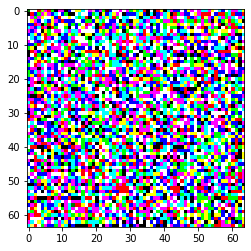

In [36]:
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False) 
plt.imshow(generated_image[0, :, :, :])

### 2.2 Discriminator

In [10]:
def make_discriminator_model():

    model = tf.keras.Sequential()
    
    model.add(layers.Conv2D(32, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[img_size_target, img_size_target, 3]))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))
    
    model.add(layers.Conv2D(256, (5, 5), strides=(1, 1), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    model.add(layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.2))

    model.add(layers.Flatten())
              
    model.add(layers.Dense(1, activation='sigmoid'))
    
    return model

In [37]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.49880326]], shape=(1, 1), dtype=float32)


### 2.3 Loss and Optimizer

In [27]:
LR_D = 0.0001
LR_G = 0.0001

In [28]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

In [29]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [30]:
def generator_loss(fake_output):
    loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    return loss

In [31]:
generator_optimizer = tf.keras.optimizers.Adam(LR_G)
discriminator_optimizer = tf.keras.optimizers.Adam(LR_D)

In [32]:
checkpoint_dir = './training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## 3. Training

In [33]:
generator.load_weights('manually_saved_weights/generator/200_epochs')
discriminator.load_weights('manually_saved_weights/discriminator/200_epochs')

In [34]:
EPOCHS = 200
noise_dim = 100
num_examples_to_generate = 16

# We will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [38]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([images.shape[0], noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)

        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        
        disc_loss = discriminator_loss(real_output, fake_output)
        
    
    # finds the derivatives of the loss with respect to the training variables
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    
    return (disc_loss, gen_loss)

In [39]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(4,4))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(tf.cast(predictions[i, :, :, :] * 127.5 + 127.5, dtype="uint8"))
        plt.axis('off')

#   plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

In [40]:
def display_metrics(disc_loss, gen_loss, epoch):

    # Plot losses per image batch

    plt.plot(range(0,len(disc_loss)) , disc_loss, label='Disciminator Loss')
    plt.plot(range(0,len(gen_loss)) , gen_loss, label='Generator Loss')
    plt.ylabel('Loss')
    plt.xlabel('Mini Batch Iteration')
    plt.title('DCGAN Loss for Epoch {}'.format(epoch))
    plt.legend()
    plt.show()

In [41]:
def train(dataset, epochs):
    loss_metrics = np.empty((1,2))
    global_disc_loss = []
    global_gen_loss = []

    for epoch in range(epochs):
        
        disc_loss = []
        gen_loss = []
        
        epoch_disc_loss, epoch_gen_loss = 0, 0
    
        start = time.time()

        for image_batch in dataset:
            (d_loss, g_loss) = train_step(image_batch)
            disc_loss.append(d_loss)
            gen_loss.append(g_loss)
        
        global_gen_loss = np.append(global_gen_loss,([gen_loss]))
        global_disc_loss = np.append(global_disc_loss,([disc_loss]))
        
        
#         Metrics
        
        print('EPOCH',epoch,'took',np.round(time.time()-start,1),'sec')
        print('Gen_loss mean=',np.mean(gen_loss),'std=',np.std(gen_loss))
        print('Disc_loss mean=',np.mean(disc_loss),'std=',np.std(disc_loss))
        
        display_metrics(disc_loss, gen_loss, epoch)
        
#         display.clear_output(wait=True)
        generate_and_save_images(generator,
                                 epoch + 1,
                                 seed)

            # Save the model every 15 epochs
        if (epoch + 1) % 100 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)


        # Generate after the final epoch
    generate_and_save_images(generator,
                   epochs,
                   seed)


EPOCH 0 took 8.2 sec
Gen_loss mean= 12.780553 std= 4.90956
Disc_loss mean= 0.0035452186 std= 0.0074933413


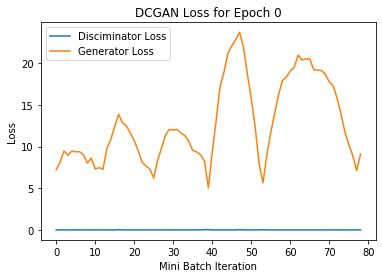

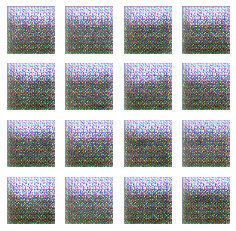

EPOCH 1 took 8.2 sec
Gen_loss mean= 13.856313 std= 8.053422
Disc_loss mean= 0.26028022 std= 1.4147295


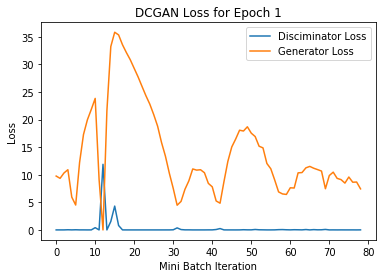

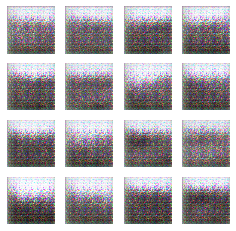

EPOCH 2 took 8.2 sec
Gen_loss mean= 8.682054 std= 2.3617449
Disc_loss mean= 0.017332816 std= 0.018345878


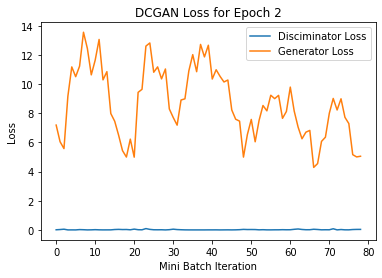

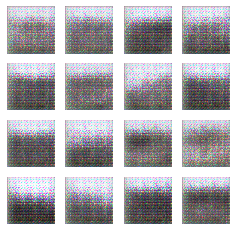

EPOCH 3 took 8.2 sec
Gen_loss mean= 8.544588 std= 1.9295635
Disc_loss mean= 0.01803142 std= 0.0344234


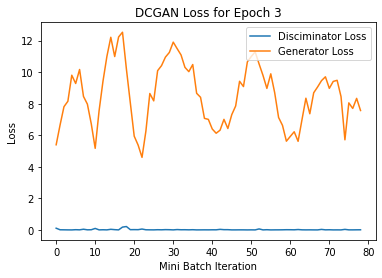

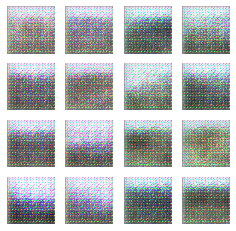

EPOCH 4 took 8.2 sec
Gen_loss mean= 8.2853565 std= 1.2826573
Disc_loss mean= 0.008550382 std= 0.013079662


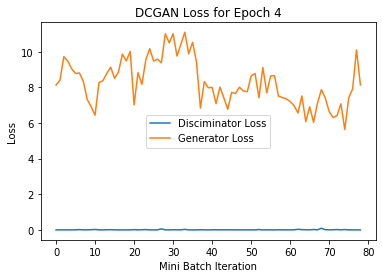

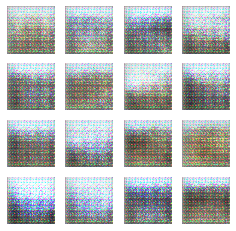

EPOCH 5 took 8.3 sec
Gen_loss mean= 8.957143 std= 2.2347867
Disc_loss mean= 0.013772089 std= 0.034711674


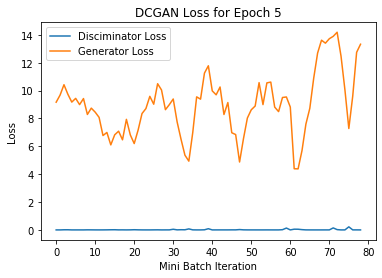

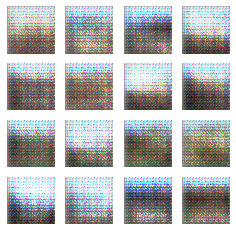

EPOCH 6 took 8.3 sec
Gen_loss mean= 12.023293 std= 3.5738127
Disc_loss mean= 0.05324415 std= 0.15004256


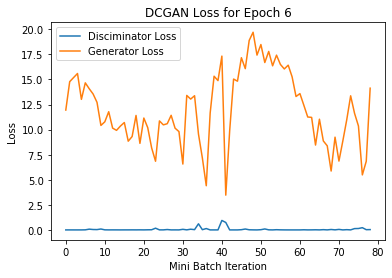

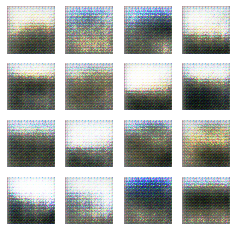

EPOCH 7 took 8.3 sec
Gen_loss mean= 10.86448 std= 5.6083894
Disc_loss mean= 0.08332325 std= 0.18906586


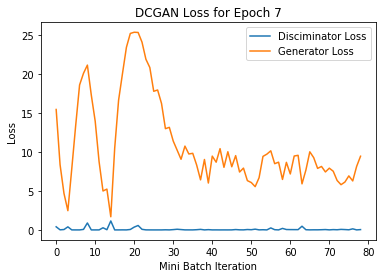

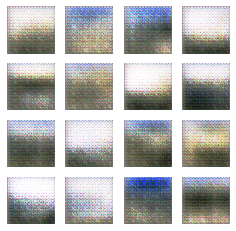

EPOCH 8 took 8.3 sec
Gen_loss mean= 10.359067 std= 4.4278297
Disc_loss mean= 0.0589335 std= 0.14015794


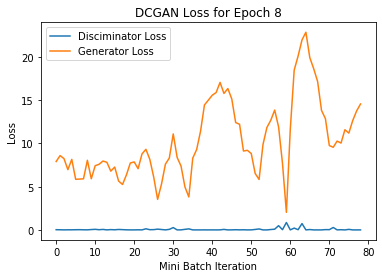

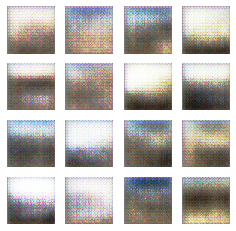

EPOCH 9 took 8.3 sec
Gen_loss mean= 10.522312 std= 2.9822357
Disc_loss mean= 0.048259433 std= 0.067036666


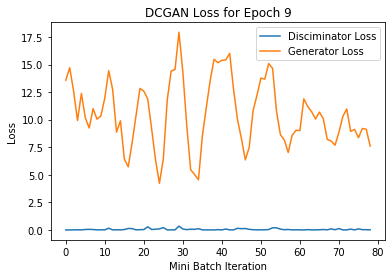

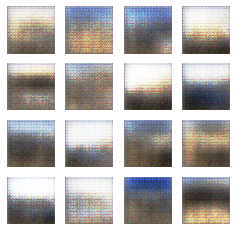

EPOCH 10 took 8.3 sec
Gen_loss mean= 10.159808 std= 3.369357
Disc_loss mean= 0.034406636 std= 0.06052969


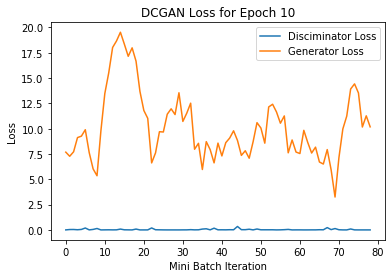

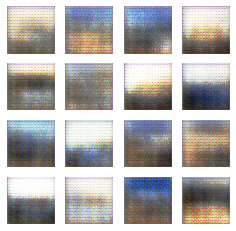

EPOCH 11 took 8.3 sec
Gen_loss mean= 10.158161 std= 3.6205258
Disc_loss mean= 0.08951083 std= 0.3133292


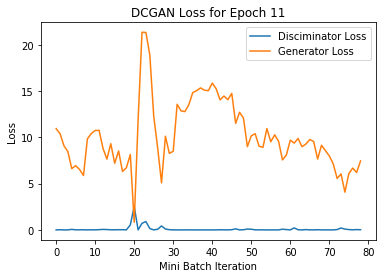

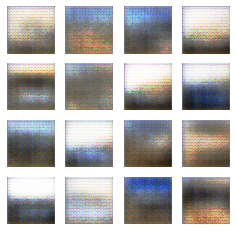

EPOCH 12 took 8.3 sec
Gen_loss mean= 9.241238 std= 2.8796358
Disc_loss mean= 0.05081697 std= 0.08092483


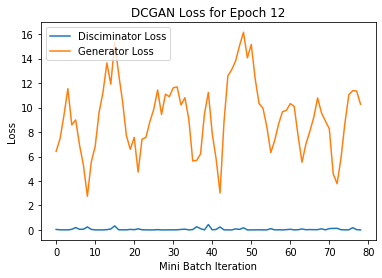

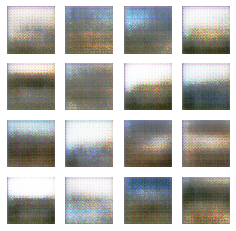

EPOCH 13 took 8.3 sec
Gen_loss mean= 10.972568 std= 4.7650466
Disc_loss mean= 0.06712702 std= 0.18848875


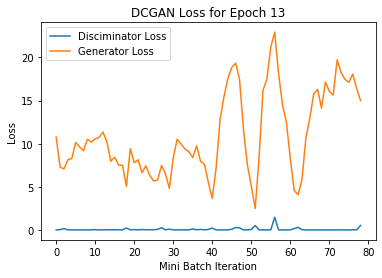

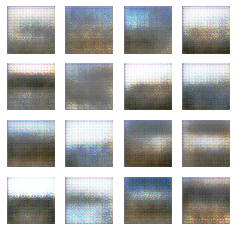

EPOCH 14 took 8.3 sec
Gen_loss mean= 10.392903 std= 3.3777804
Disc_loss mean= 0.035053007 std= 0.06428912


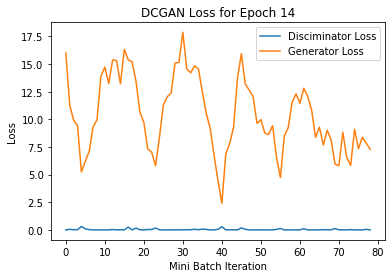

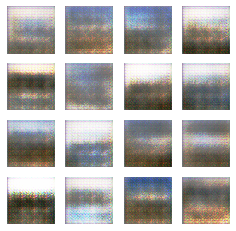

EPOCH 15 took 8.3 sec
Gen_loss mean= 10.725911 std= 5.6581244
Disc_loss mean= 0.07630856 std= 0.23172425


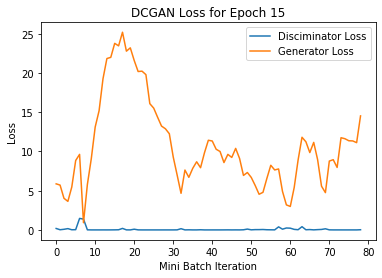

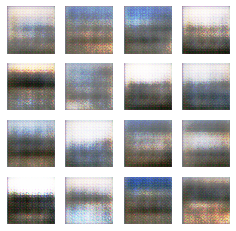

EPOCH 16 took 8.4 sec
Gen_loss mean= 10.001129 std= 5.4982386
Disc_loss mean= 0.101897225 std= 0.40426484


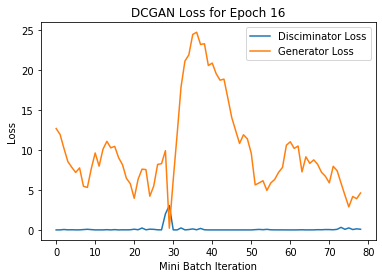

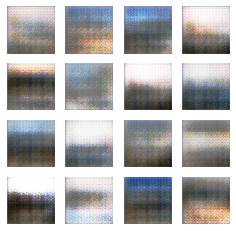

EPOCH 17 took 8.3 sec
Gen_loss mean= 10.778788 std= 4.8443346
Disc_loss mean= 0.036140513 std= 0.08550821


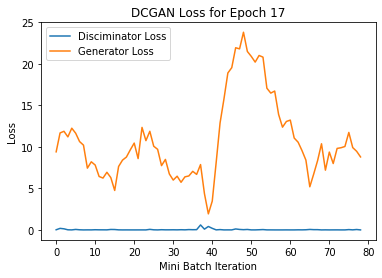

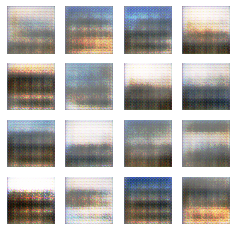

EPOCH 18 took 8.3 sec
Gen_loss mean= 8.278095 std= 4.127045
Disc_loss mean= 0.122593544 std= 0.4383676


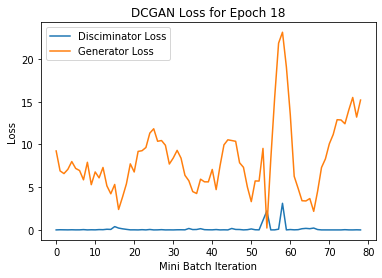

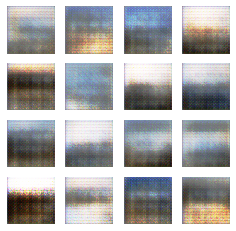

EPOCH 19 took 8.3 sec
Gen_loss mean= 7.513805 std= 2.732914
Disc_loss mean= 0.0496008 std= 0.08116302


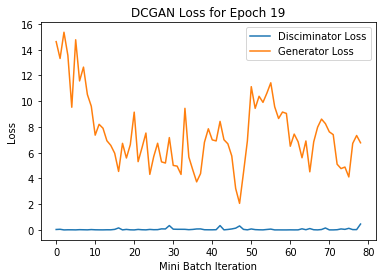

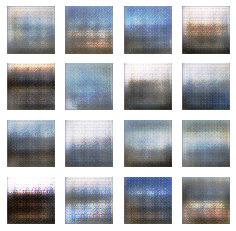

EPOCH 20 took 8.3 sec
Gen_loss mean= 10.226715 std= 5.9123545
Disc_loss mean= 0.14585167 std= 0.3718118


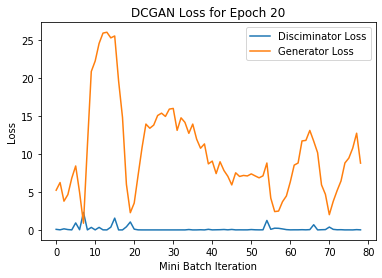

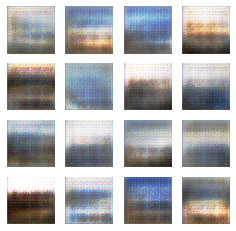

EPOCH 21 took 8.3 sec
Gen_loss mean= 9.578993 std= 4.5132537
Disc_loss mean= 0.12150311 std= 0.31677893


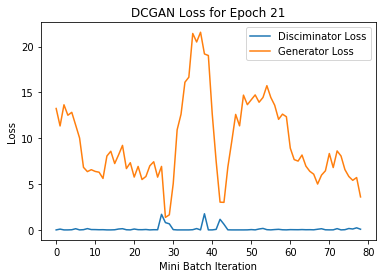

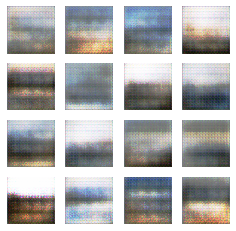

EPOCH 22 took 8.4 sec
Gen_loss mean= 10.0280905 std= 4.8133883
Disc_loss mean= 0.08669373 std= 0.19328147


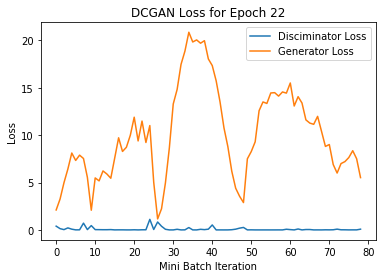

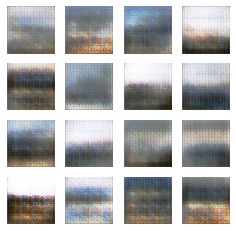

EPOCH 23 took 8.4 sec
Gen_loss mean= 8.651076 std= 3.4290547
Disc_loss mean= 0.0739602 std= 0.1594791


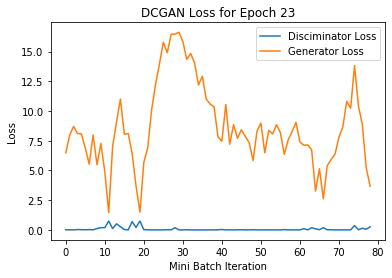

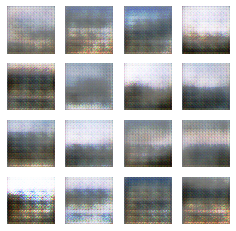

EPOCH 24 took 8.4 sec
Gen_loss mean= 10.246462 std= 4.1111465
Disc_loss mean= 0.062223252 std= 0.1890989


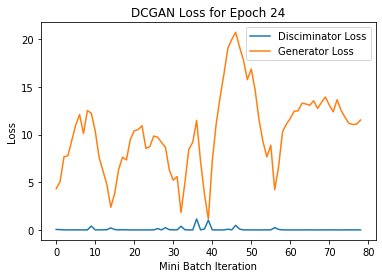

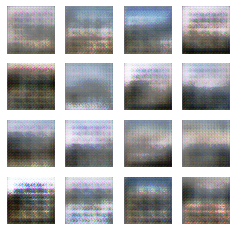

EPOCH 25 took 8.4 sec
Gen_loss mean= 7.182535 std= 2.6026068
Disc_loss mean= 0.08091499 std= 0.19032137


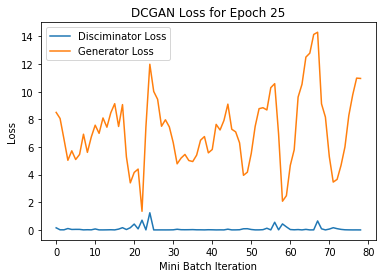

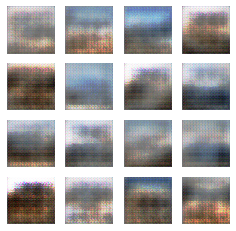

EPOCH 26 took 8.4 sec
Gen_loss mean= 10.2058 std= 5.2677746
Disc_loss mean= 0.08820565 std= 0.1761442


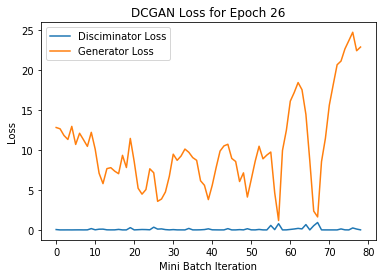

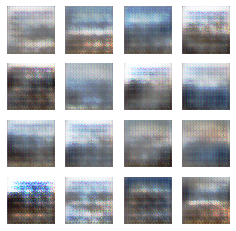

EPOCH 27 took 8.4 sec
Gen_loss mean= 9.345723 std= 5.29639
Disc_loss mean= 0.24606767 std= 0.9713461


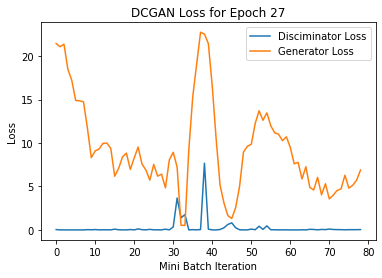

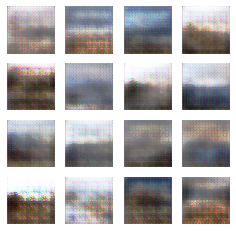

EPOCH 28 took 8.4 sec
Gen_loss mean= 5.3542075 std= 1.8762039
Disc_loss mean= 0.10399269 std= 0.12931202


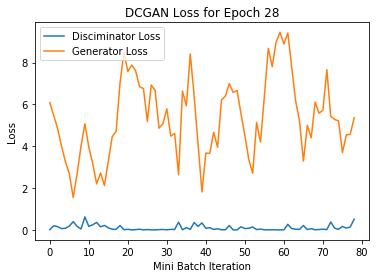

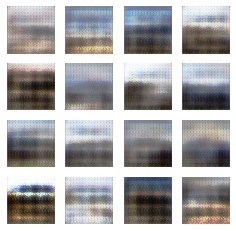

EPOCH 29 took 8.4 sec
Gen_loss mean= 8.192409 std= 4.8054953
Disc_loss mean= 0.11472153 std= 0.33322844


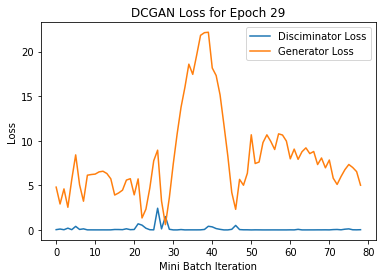

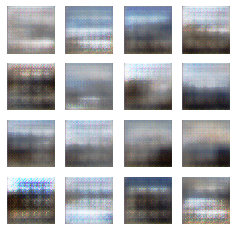

EPOCH 30 took 8.4 sec
Gen_loss mean= 5.710065 std= 1.3340617
Disc_loss mean= 0.0736882 std= 0.1925697


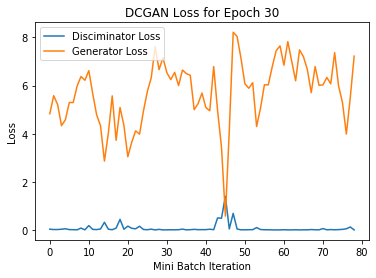

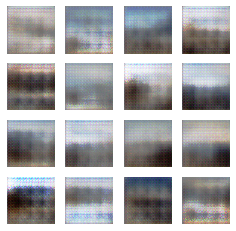

EPOCH 31 took 8.4 sec
Gen_loss mean= 7.3537807 std= 3.293487
Disc_loss mean= 0.10585151 std= 0.2714106


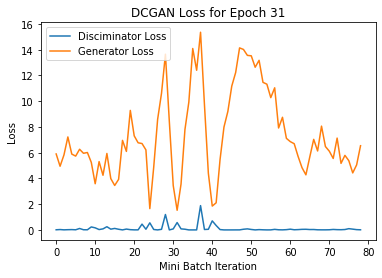

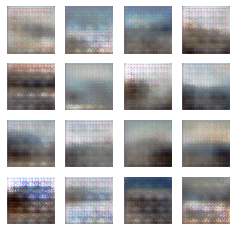

EPOCH 32 took 8.4 sec
Gen_loss mean= 7.1790795 std= 3.180368
Disc_loss mean= 0.07513865 std= 0.14673135


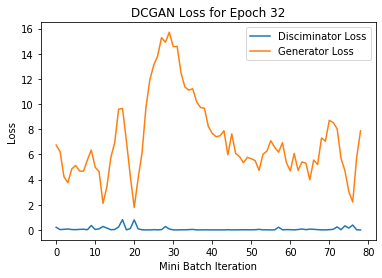

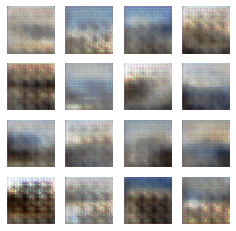

EPOCH 33 took 8.4 sec
Gen_loss mean= 8.197638 std= 3.8644555
Disc_loss mean= 0.14225456 std= 0.45822352


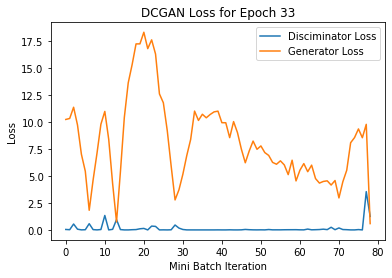

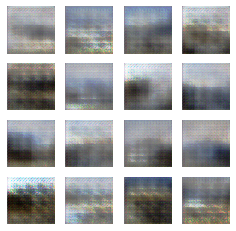

EPOCH 34 took 8.4 sec
Gen_loss mean= 8.951869 std= 4.421742
Disc_loss mean= 0.1531155 std= 0.28757727


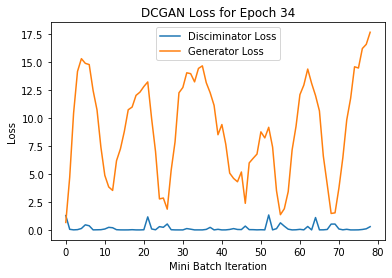

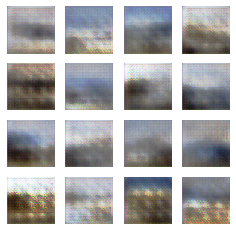

EPOCH 35 took 8.4 sec
Gen_loss mean= 7.228346 std= 2.753594
Disc_loss mean= 0.04524179 std= 0.07081723


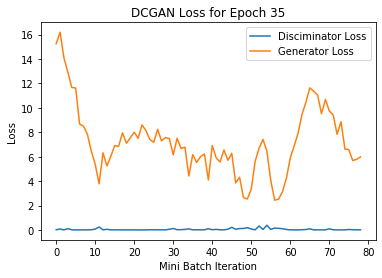

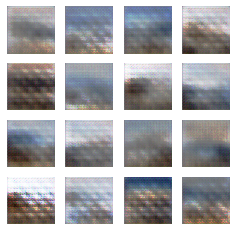

EPOCH 36 took 8.4 sec
Gen_loss mean= 7.759423 std= 4.6521053
Disc_loss mean= 0.11120142 std= 0.28730914


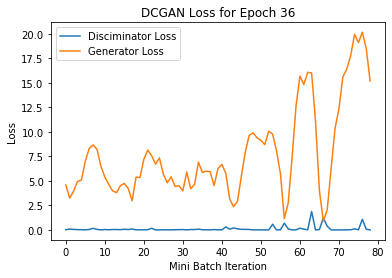

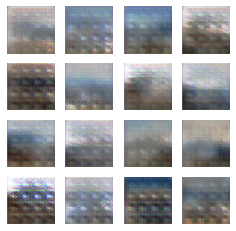

EPOCH 37 took 8.4 sec
Gen_loss mean= 6.677368 std= 2.2444212
Disc_loss mean= 0.047333553 std= 0.07815567


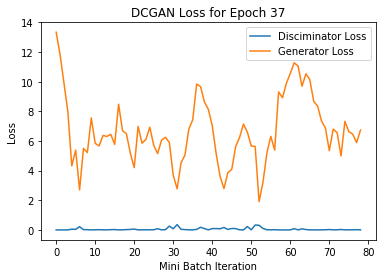

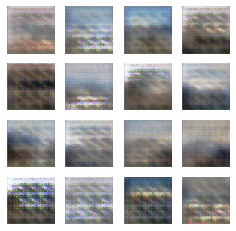

EPOCH 38 took 8.4 sec
Gen_loss mean= 7.2219553 std= 2.7771046
Disc_loss mean= 0.10085498 std= 0.3210008


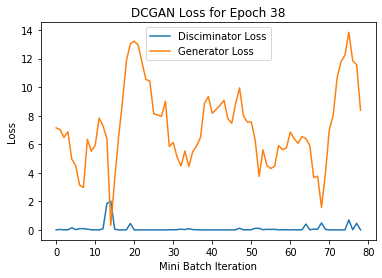

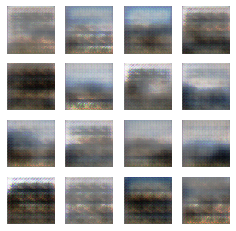

EPOCH 39 took 8.4 sec
Gen_loss mean= 6.6981225 std= 2.5224752
Disc_loss mean= 0.10026613 std= 0.2692989


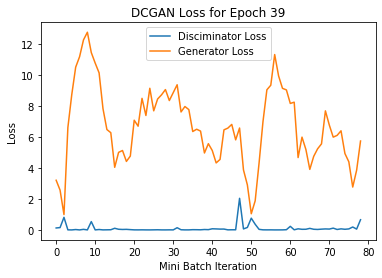

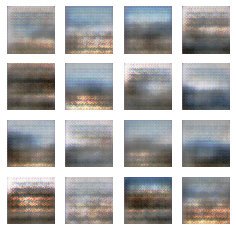

EPOCH 40 took 8.4 sec
Gen_loss mean= 6.5340977 std= 2.7384899
Disc_loss mean= 0.07886863 std= 0.28130248


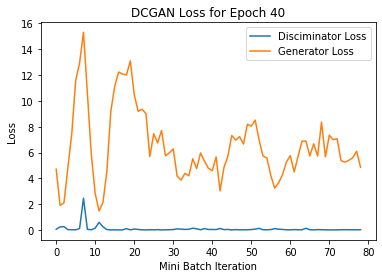

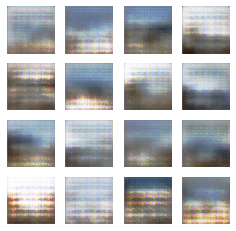

EPOCH 41 took 8.4 sec
Gen_loss mean= 5.541397 std= 1.4635607
Disc_loss mean= 0.03946001 std= 0.041809574


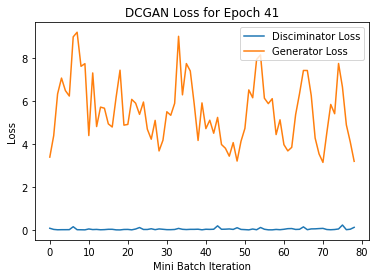

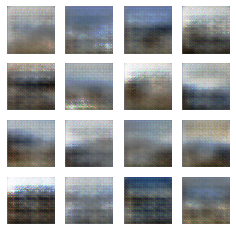

EPOCH 42 took 8.4 sec
Gen_loss mean= 7.2813973 std= 3.0672169
Disc_loss mean= 0.08095401 std= 0.27902398


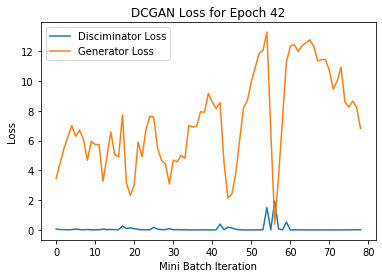

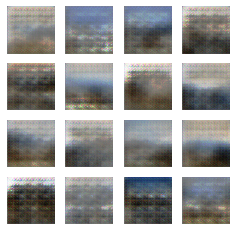

EPOCH 43 took 8.4 sec
Gen_loss mean= 6.838608 std= 2.9085183
Disc_loss mean= 0.0906879 std= 0.29738492


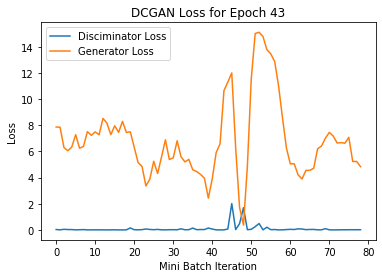

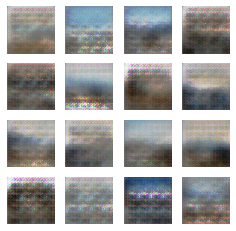

EPOCH 44 took 8.4 sec
Gen_loss mean= 6.4135365 std= 2.798631
Disc_loss mean= 0.093132555 std= 0.21265538


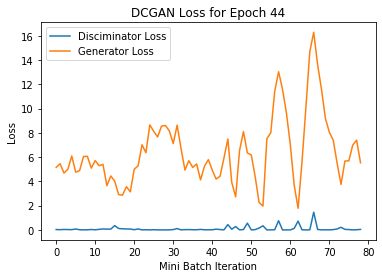

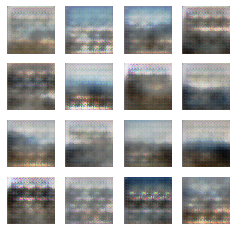

EPOCH 45 took 8.4 sec
Gen_loss mean= 6.402667 std= 2.2144332
Disc_loss mean= 0.058094062 std= 0.11416928


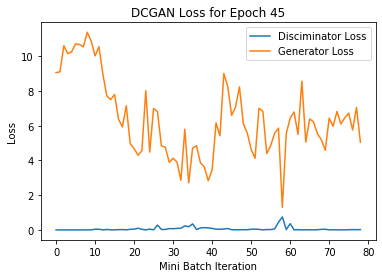

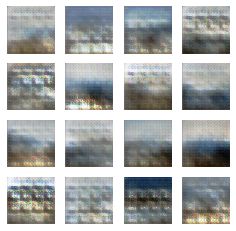

EPOCH 46 took 8.4 sec
Gen_loss mean= 7.371769 std= 3.6709588
Disc_loss mean= 0.14463563 std= 0.4435878


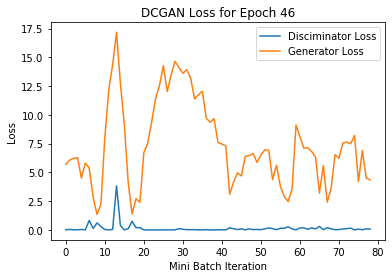

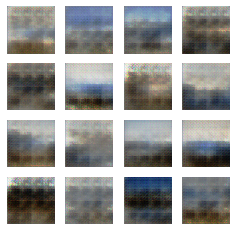

EPOCH 47 took 8.3 sec
Gen_loss mean= 7.6017547 std= 3.6897593
Disc_loss mean= 0.078309655 std= 0.16761966


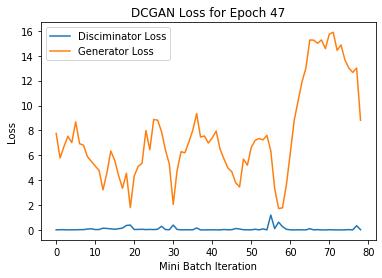

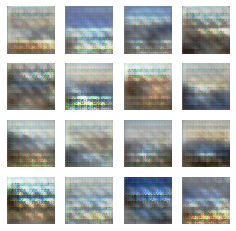

EPOCH 48 took 8.4 sec
Gen_loss mean= 7.4252505 std= 2.806213
Disc_loss mean= 0.08232017 std= 0.23281896


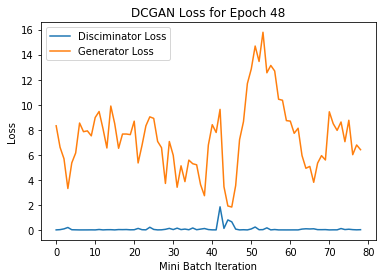

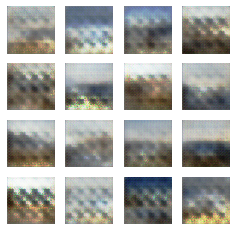

EPOCH 49 took 8.4 sec
Gen_loss mean= 6.253205 std= 2.8667648
Disc_loss mean= 0.1483222 std= 0.4177775


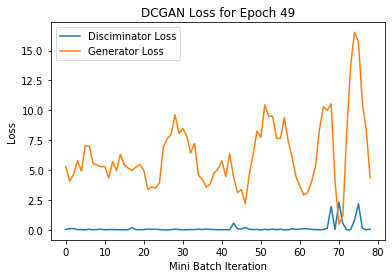

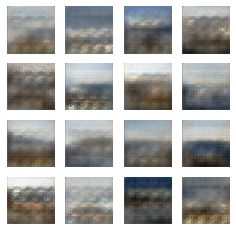

EPOCH 50 took 8.4 sec
Gen_loss mean= 6.4767017 std= 3.891936
Disc_loss mean= 0.067637116 std= 0.123229824


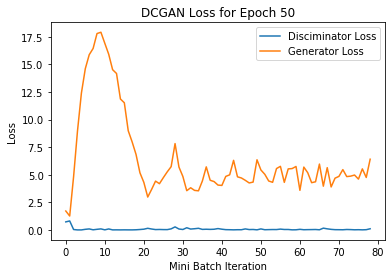

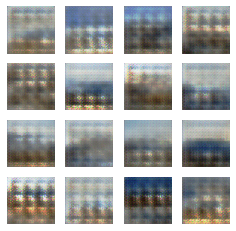

EPOCH 51 took 8.4 sec
Gen_loss mean= 5.5955424 std= 1.604779
Disc_loss mean= 0.048407625 std= 0.06598381


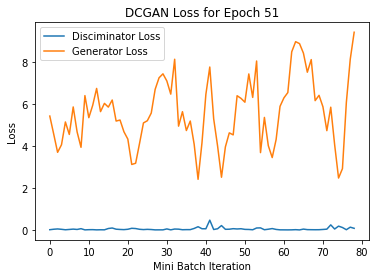

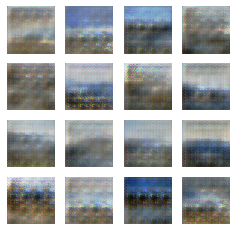

EPOCH 52 took 8.4 sec
Gen_loss mean= 7.617033 std= 4.238491
Disc_loss mean= 0.19746596 std= 0.46062967


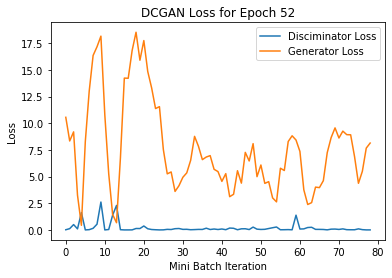

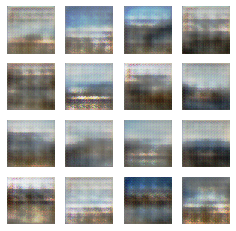

EPOCH 53 took 8.4 sec
Gen_loss mean= 5.2253394 std= 1.2389467
Disc_loss mean= 0.052996363 std= 0.05437037


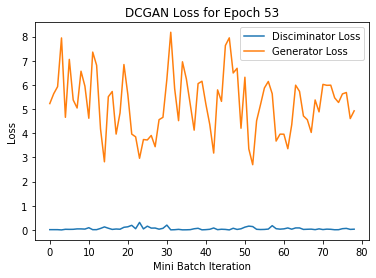

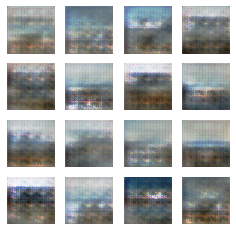

EPOCH 54 took 8.4 sec
Gen_loss mean= 6.567685 std= 2.9345858
Disc_loss mean= 0.07471017 std= 0.13141756


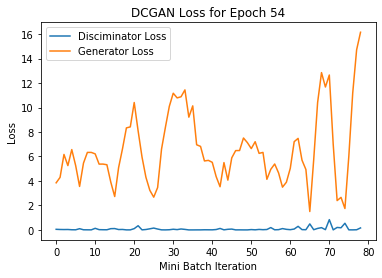

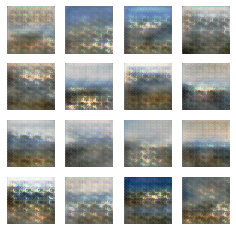

EPOCH 55 took 8.4 sec
Gen_loss mean= 7.4600334 std= 3.267055
Disc_loss mean= 0.04553669 std= 0.071706325


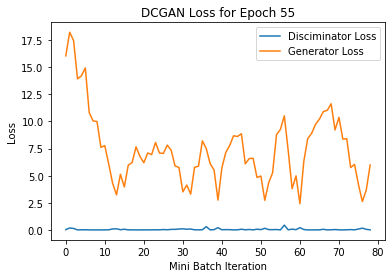

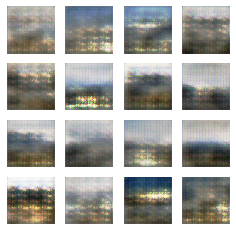

EPOCH 56 took 8.4 sec
Gen_loss mean= 7.1377077 std= 3.9065065
Disc_loss mean= 0.1669594 std= 0.60245824


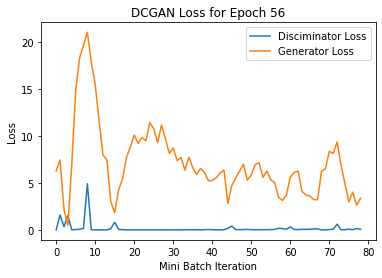

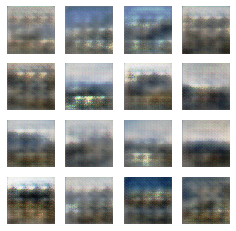

EPOCH 57 took 8.4 sec
Gen_loss mean= 6.047084 std= 1.9677188
Disc_loss mean= 0.06775204 std= 0.107524596


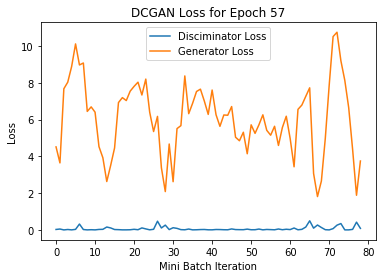

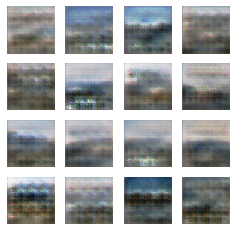

EPOCH 58 took 8.4 sec
Gen_loss mean= 7.7464585 std= 3.2842646
Disc_loss mean= 0.052544877 std= 0.10100797


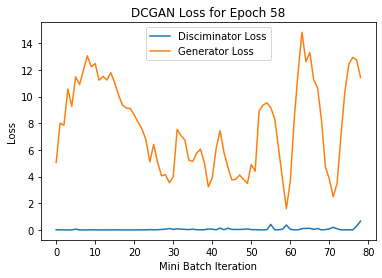

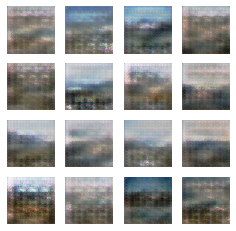

EPOCH 59 took 8.4 sec
Gen_loss mean= 8.635935 std= 3.9318345
Disc_loss mean= 0.10029384 std= 0.20261


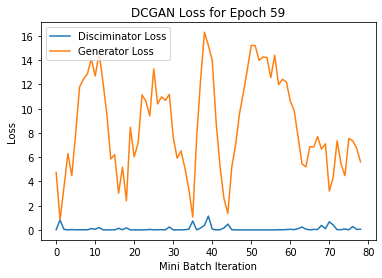

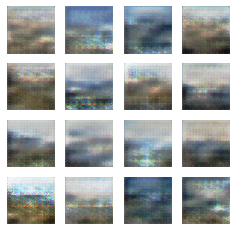

EPOCH 60 took 8.4 sec
Gen_loss mean= 8.068261 std= 4.8423414
Disc_loss mean= 0.104006395 std= 0.2941088


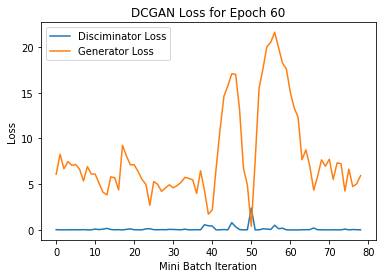

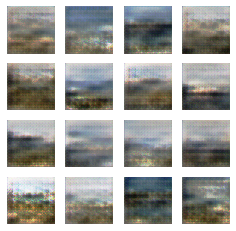

EPOCH 61 took 8.4 sec
Gen_loss mean= 7.2366757 std= 2.7886086
Disc_loss mean= 0.07795241 std= 0.14125079


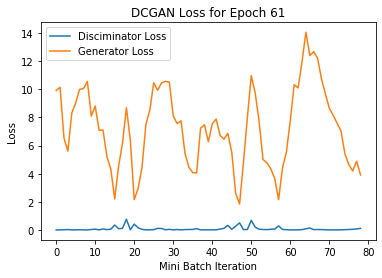

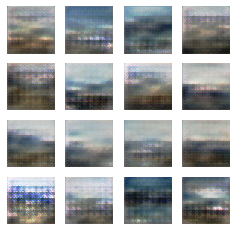

EPOCH 62 took 8.4 sec
Gen_loss mean= 6.574292 std= 2.0930617
Disc_loss mean= 0.041644722 std= 0.06641383


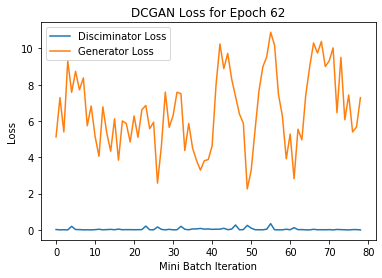

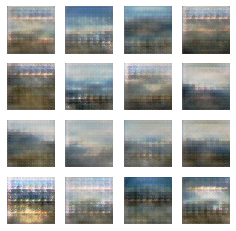

EPOCH 63 took 8.4 sec
Gen_loss mean= 8.003277 std= 3.2021122
Disc_loss mean= 0.106072664 std= 0.34929264


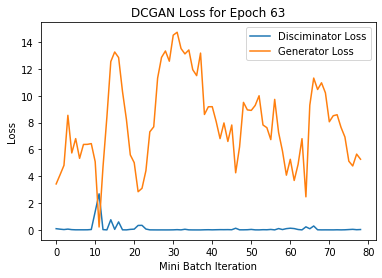

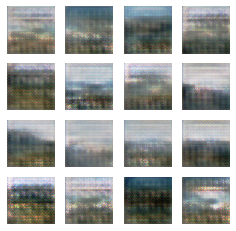

EPOCH 64 took 8.4 sec
Gen_loss mean= 7.5958514 std= 3.7039704
Disc_loss mean= 0.055642452 std= 0.10819497


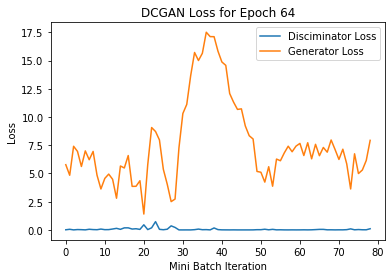

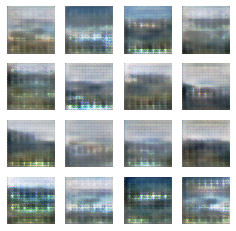

EPOCH 65 took 8.4 sec
Gen_loss mean= 7.740276 std= 3.3541443
Disc_loss mean= 0.06501001 std= 0.1088503


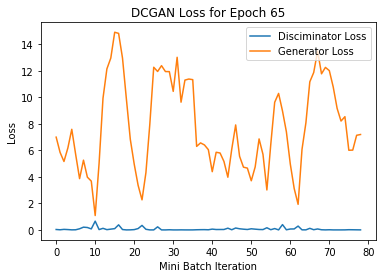

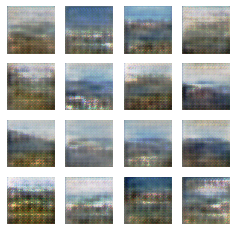

EPOCH 66 took 8.4 sec
Gen_loss mean= 7.8711586 std= 4.1564374
Disc_loss mean= 0.13146968 std= 0.31270626


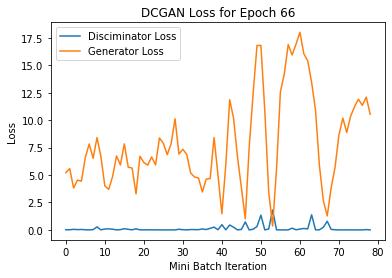

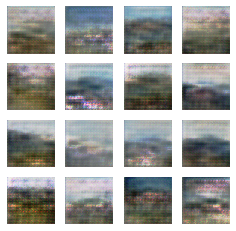

EPOCH 67 took 8.4 sec
Gen_loss mean= 6.400268 std= 2.0700867
Disc_loss mean= 0.071132764 std= 0.12685913


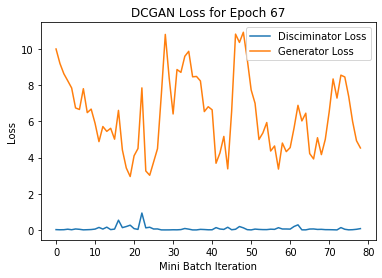

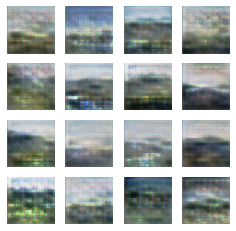

EPOCH 68 took 8.3 sec
Gen_loss mean= 7.5066476 std= 3.3039448
Disc_loss mean= 0.08999438 std= 0.16656198


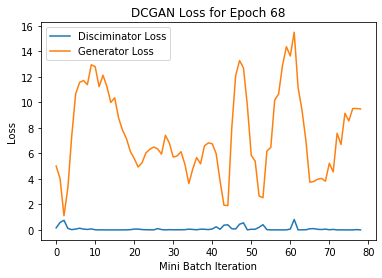

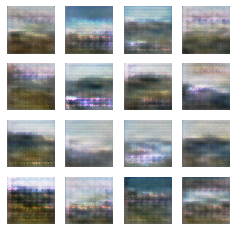

EPOCH 69 took 8.4 sec
Gen_loss mean= 6.0811863 std= 1.6242476
Disc_loss mean= 0.043867953 std= 0.059716836


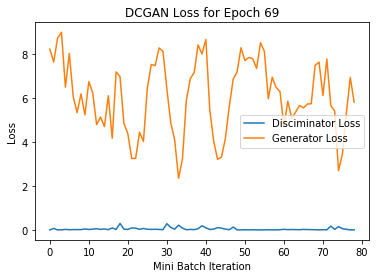

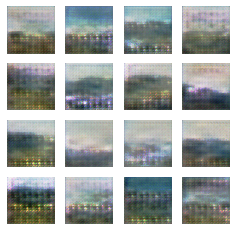

EPOCH 70 took 8.4 sec
Gen_loss mean= 8.212348 std= 3.6368008
Disc_loss mean= 0.071114846 std= 0.13465427


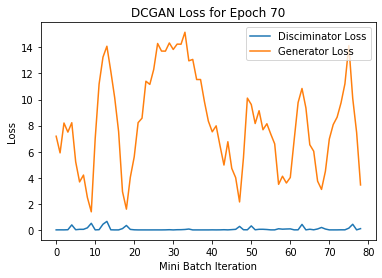

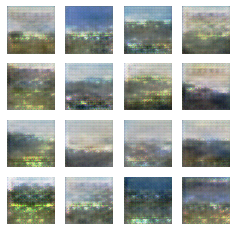

EPOCH 71 took 8.4 sec
Gen_loss mean= 6.7934594 std= 2.7264042
Disc_loss mean= 0.05869723 std= 0.14478508


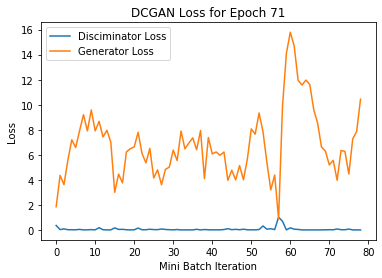

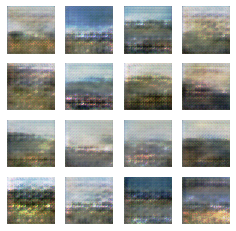

EPOCH 72 took 8.4 sec
Gen_loss mean= 6.932374 std= 2.171923
Disc_loss mean= 0.036597602 std= 0.05242307


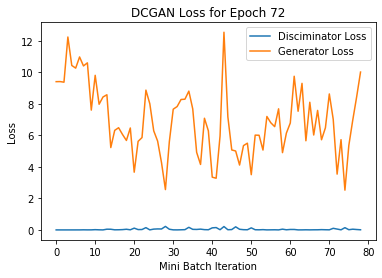

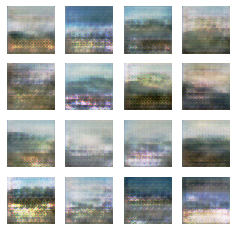

EPOCH 73 took 8.4 sec
Gen_loss mean= 7.1811657 std= 3.459619
Disc_loss mean= 0.15189216 std= 0.406121


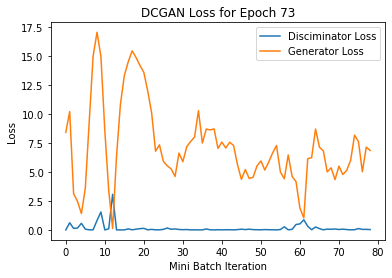

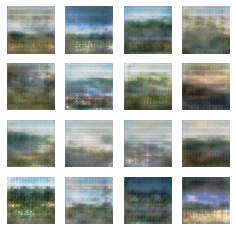

EPOCH 74 took 8.4 sec
Gen_loss mean= 5.68566 std= 1.8708062
Disc_loss mean= 0.12251998 std= 0.39410135


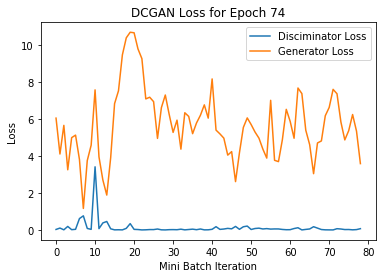

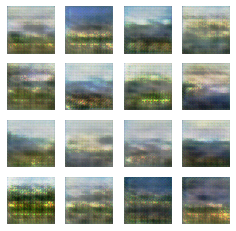

EPOCH 75 took 8.4 sec
Gen_loss mean= 7.045157 std= 2.4852424
Disc_loss mean= 0.08952073 std= 0.14455853


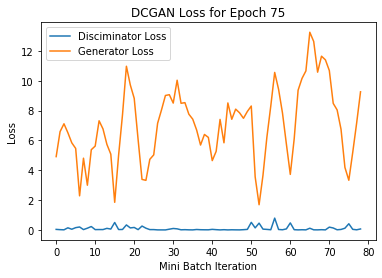

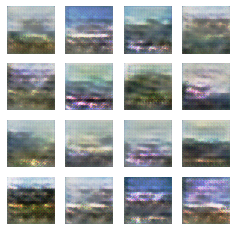

EPOCH 76 took 8.4 sec
Gen_loss mean= 7.088915 std= 2.521947
Disc_loss mean= 0.051697563 std= 0.10323942


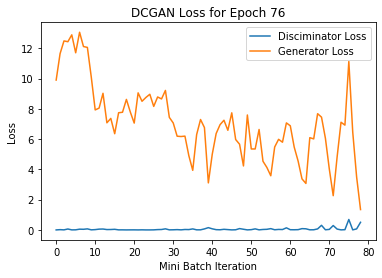

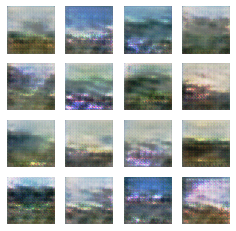

EPOCH 77 took 8.4 sec
Gen_loss mean= 8.048822 std= 3.2878242
Disc_loss mean= 0.05924398 std= 0.11542056


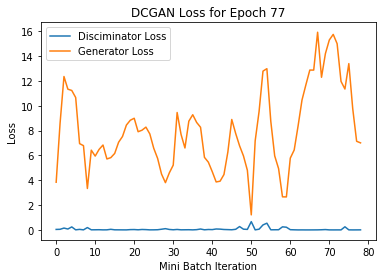

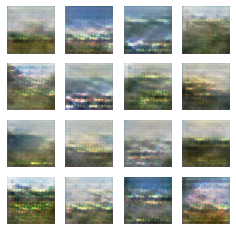

EPOCH 78 took 8.4 sec
Gen_loss mean= 6.462524 std= 2.2340767
Disc_loss mean= 0.055678874 std= 0.09062152


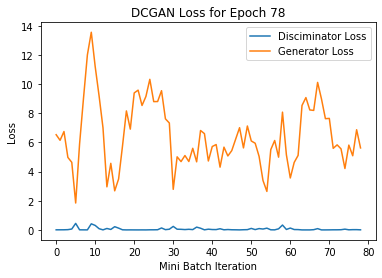

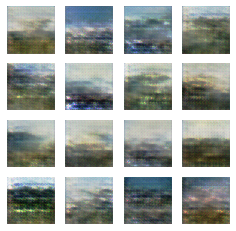

EPOCH 79 took 8.4 sec
Gen_loss mean= 7.8125625 std= 3.292394
Disc_loss mean= 0.062982716 std= 0.20841892


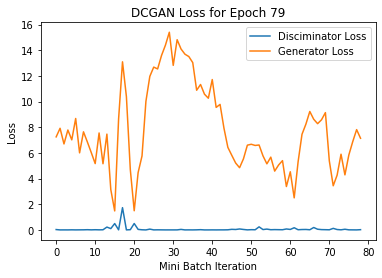

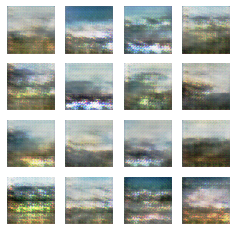

EPOCH 80 took 8.4 sec
Gen_loss mean= 5.9389477 std= 1.4773033
Disc_loss mean= 0.025099888 std= 0.038136378


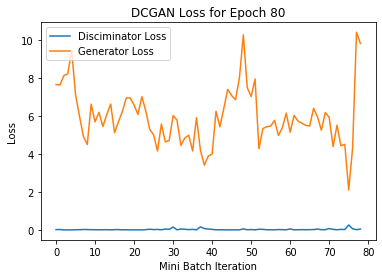

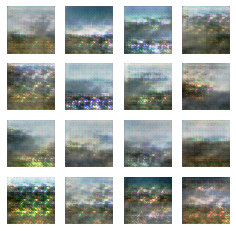

EPOCH 81 took 8.4 sec
Gen_loss mean= 7.9820294 std= 2.8697891
Disc_loss mean= 0.07766306 std= 0.178541


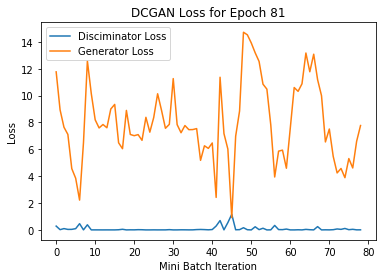

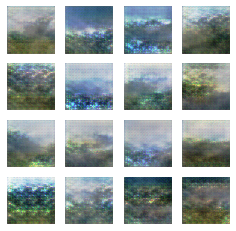

EPOCH 82 took 8.4 sec
Gen_loss mean= 7.2061434 std= 2.534256
Disc_loss mean= 0.08277993 std= 0.21656153


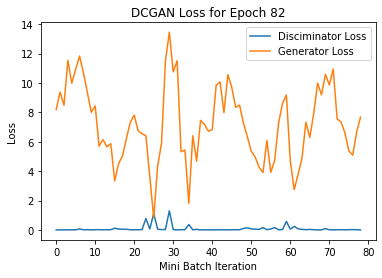

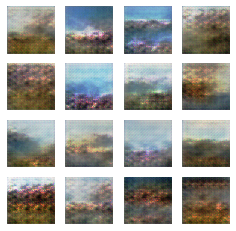

EPOCH 83 took 8.4 sec
Gen_loss mean= 6.6400766 std= 1.8313577
Disc_loss mean= 0.038016852 std= 0.061380073


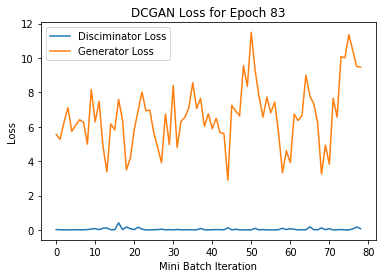

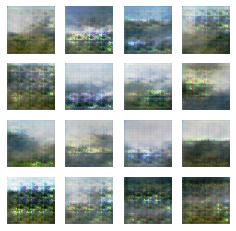

EPOCH 84 took 8.4 sec
Gen_loss mean= 7.406596 std= 3.4817104
Disc_loss mean= 0.07228774 std= 0.11193643


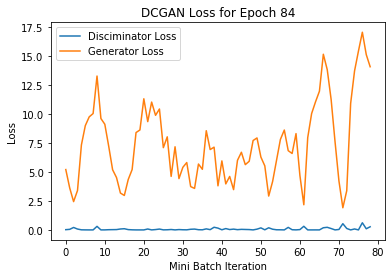

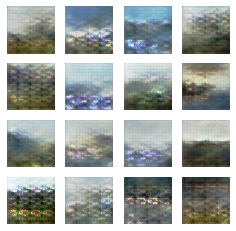

EPOCH 85 took 8.4 sec
Gen_loss mean= 8.8706875 std= 4.3835983
Disc_loss mean= 0.07876683 std= 0.14088449


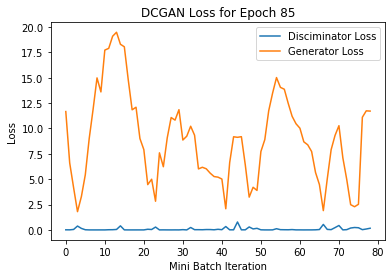

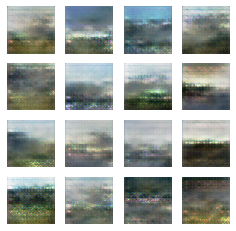

EPOCH 86 took 8.4 sec
Gen_loss mean= 7.1546483 std= 2.698799
Disc_loss mean= 0.05865109 std= 0.15928887


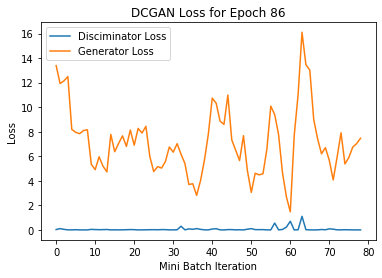

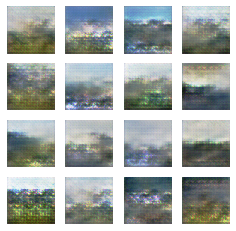

EPOCH 87 took 8.4 sec
Gen_loss mean= 8.010309 std= 4.333016
Disc_loss mean= 0.16269965 std= 0.44514623


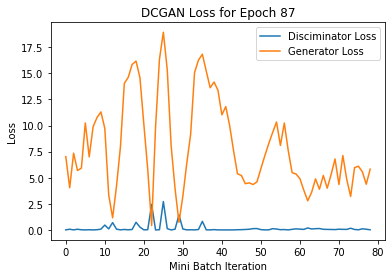

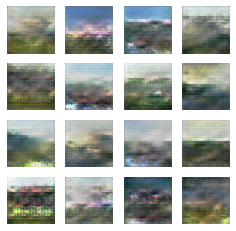

EPOCH 88 took 8.4 sec
Gen_loss mean= 6.450751 std= 2.8531644
Disc_loss mean= 0.0997719 std= 0.16347703


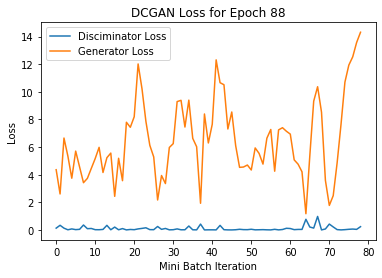

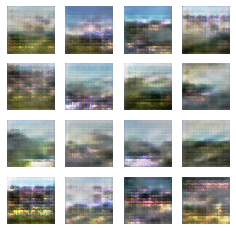

EPOCH 89 took 8.4 sec
Gen_loss mean= 6.5063825 std= 2.5323439
Disc_loss mean= 0.063227996 std= 0.07541584


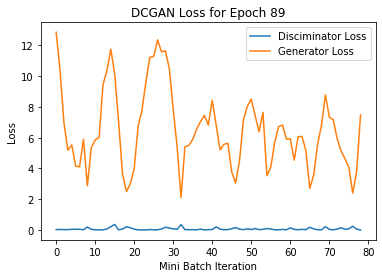

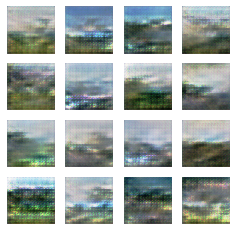

EPOCH 90 took 8.4 sec
Gen_loss mean= 7.5984573 std= 3.458674
Disc_loss mean= 0.119791225 std= 0.33095858


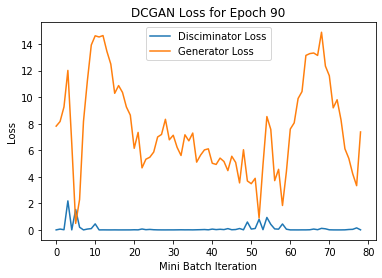

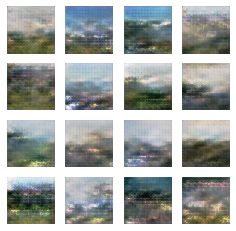

EPOCH 91 took 8.4 sec
Gen_loss mean= 7.1918225 std= 3.6368716
Disc_loss mean= 0.32769576 std= 0.7291483


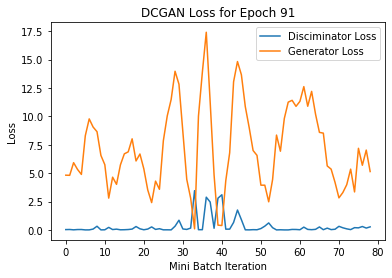

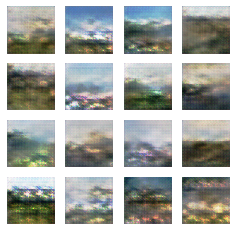

EPOCH 92 took 8.4 sec
Gen_loss mean= 5.839377 std= 2.0896811
Disc_loss mean= 0.07940423 std= 0.09087444


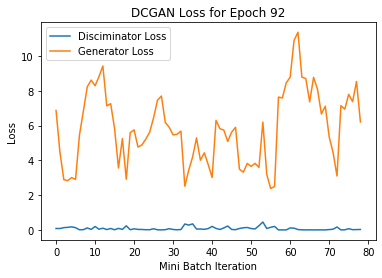

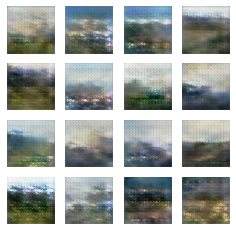

EPOCH 93 took 8.4 sec
Gen_loss mean= 6.2978 std= 2.795988
Disc_loss mean= 0.06261093 std= 0.07695937


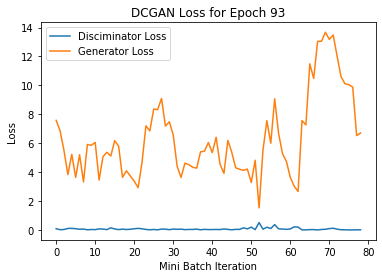

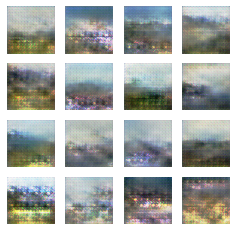

EPOCH 94 took 8.4 sec
Gen_loss mean= 5.9974523 std= 1.5435901
Disc_loss mean= 0.04253631 std= 0.049674932


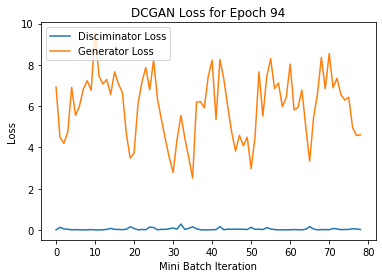

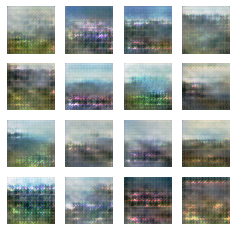

EPOCH 95 took 8.4 sec
Gen_loss mean= 7.010933 std= 2.995402
Disc_loss mean= 0.050614975 std= 0.07599225


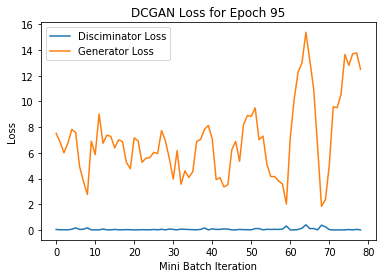

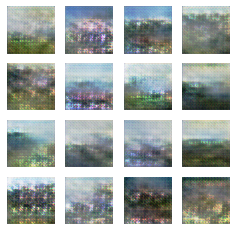

EPOCH 96 took 8.4 sec
Gen_loss mean= 7.435462 std= 2.9254825
Disc_loss mean= 0.050206106 std= 0.08285392


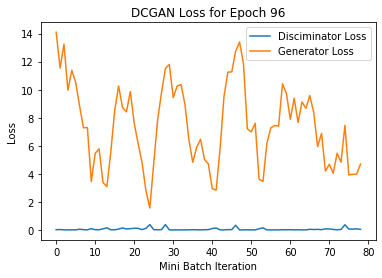

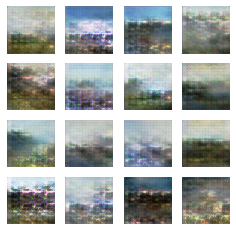

EPOCH 97 took 8.3 sec
Gen_loss mean= 7.0345373 std= 2.420257
Disc_loss mean= 0.040806856 std= 0.097171


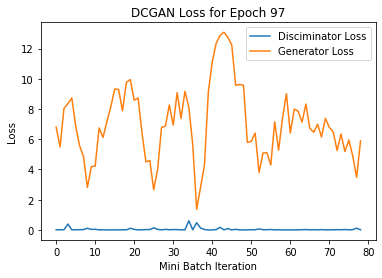

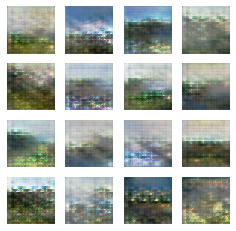

EPOCH 98 took 8.4 sec
Gen_loss mean= 7.3751035 std= 3.5711365
Disc_loss mean= 0.12639041 std= 0.28700376


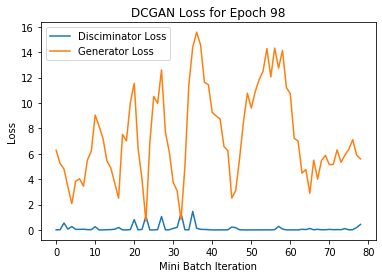

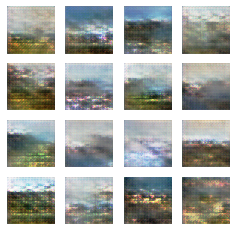

EPOCH 99 took 8.4 sec
Gen_loss mean= 7.377428 std= 2.8866422
Disc_loss mean= 0.076055355 std= 0.15058018


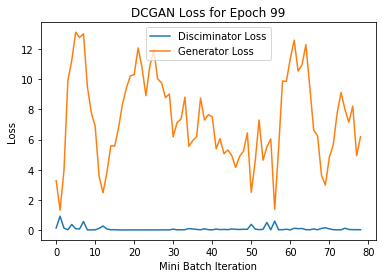

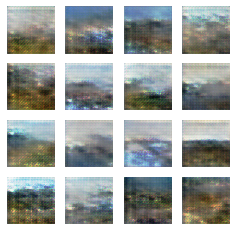

EPOCH 100 took 8.4 sec
Gen_loss mean= 6.532361 std= 2.4595456
Disc_loss mean= 0.05480074 std= 0.06990905


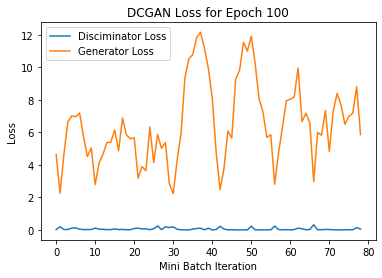

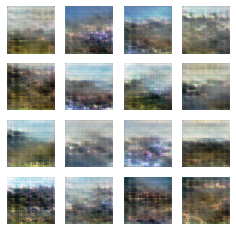

EPOCH 101 took 8.4 sec
Gen_loss mean= 7.321385 std= 3.1763527
Disc_loss mean= 0.10425238 std= 0.20206243


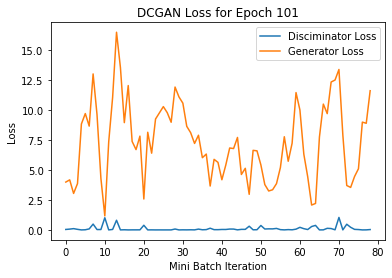

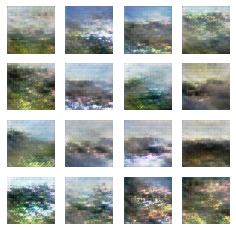

EPOCH 102 took 8.4 sec
Gen_loss mean= 8.030133 std= 3.151802
Disc_loss mean= 0.081131876 std= 0.14795484


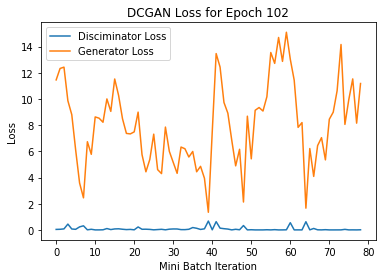

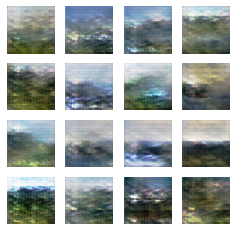

EPOCH 103 took 8.4 sec
Gen_loss mean= 7.0943675 std= 2.5064595
Disc_loss mean= 0.053290464 std= 0.08237504


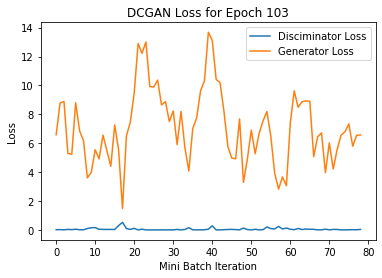

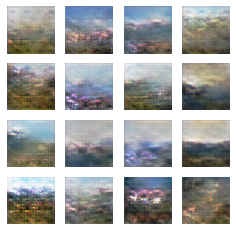

EPOCH 104 took 8.3 sec
Gen_loss mean= 6.692591 std= 2.414889
Disc_loss mean= 0.046817496 std= 0.058361966


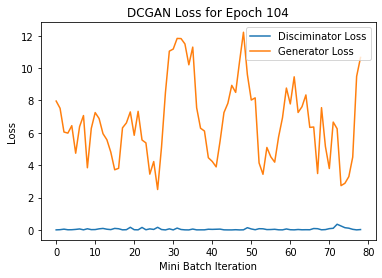

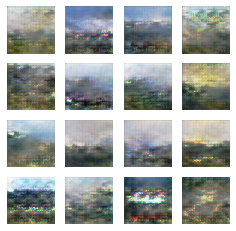

EPOCH 105 took 8.4 sec
Gen_loss mean= 7.0557113 std= 2.5369484
Disc_loss mean= 0.047573034 std= 0.07331639


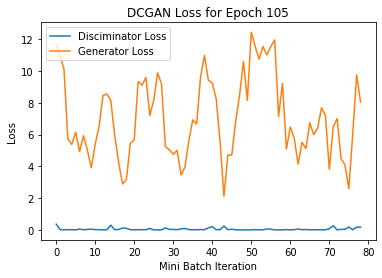

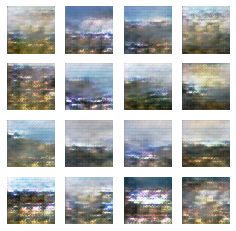

EPOCH 106 took 8.3 sec
Gen_loss mean= 6.7999268 std= 2.5269318
Disc_loss mean= 0.06996055 std= 0.16859883


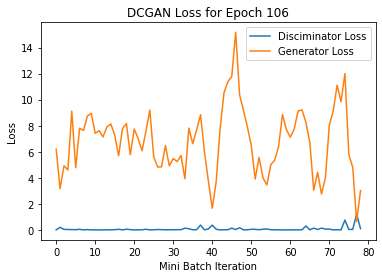

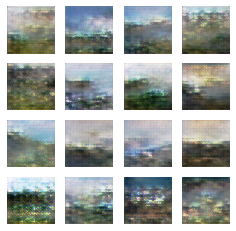

EPOCH 107 took 8.4 sec
Gen_loss mean= 7.0563254 std= 2.449985
Disc_loss mean= 0.07088245 std= 0.0981918


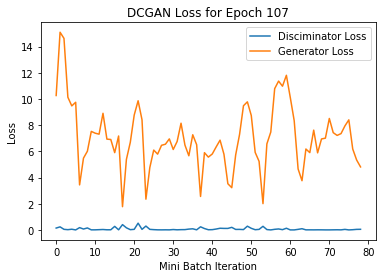

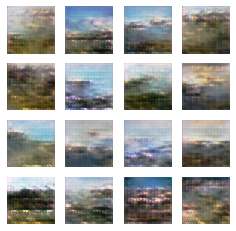

EPOCH 108 took 8.4 sec
Gen_loss mean= 7.5915627 std= 3.1152103
Disc_loss mean= 0.079100624 std= 0.15722193


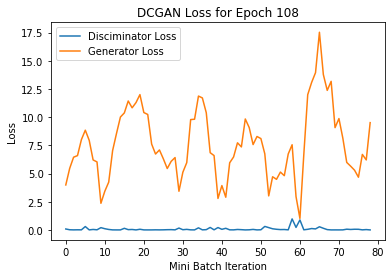

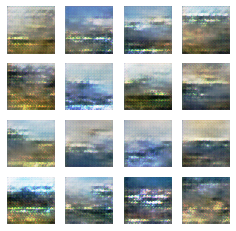

EPOCH 109 took 8.4 sec
Gen_loss mean= 7.948783 std= 3.0674734
Disc_loss mean= 0.07732853 std= 0.15448503


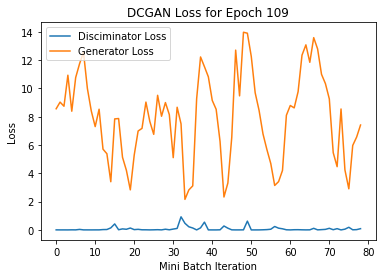

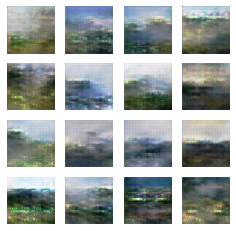

EPOCH 110 took 8.4 sec
Gen_loss mean= 7.2511263 std= 3.7274113
Disc_loss mean= 0.12044107 std= 0.29418483


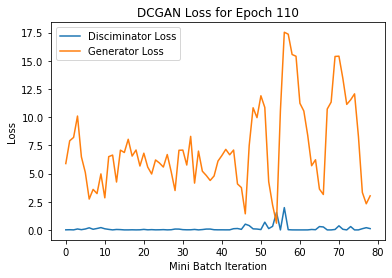

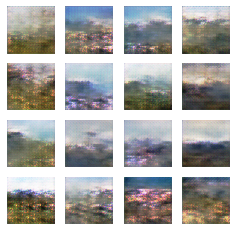

EPOCH 111 took 8.3 sec
Gen_loss mean= 7.610497 std= 3.9557164
Disc_loss mean= 0.09999813 std= 0.24848276


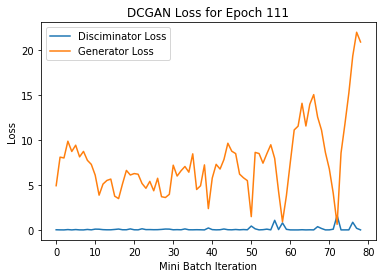

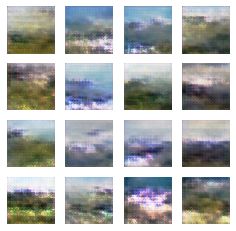

EPOCH 112 took 8.4 sec
Gen_loss mean= 8.463856 std= 4.034725
Disc_loss mean= 0.08560148 std= 0.17680447


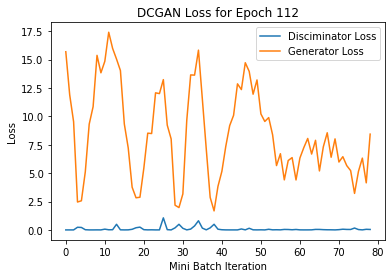

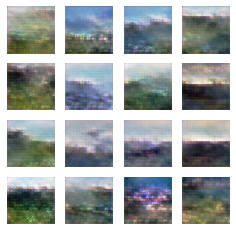

EPOCH 113 took 8.4 sec
Gen_loss mean= 7.5677404 std= 3.318851
Disc_loss mean= 0.082872465 std= 0.16185482


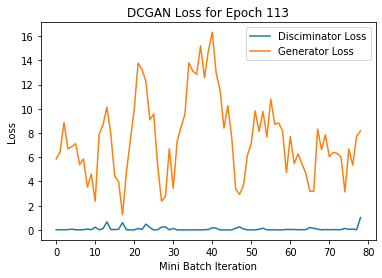

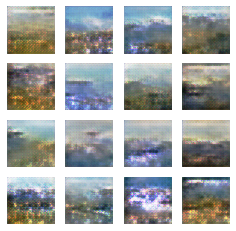

EPOCH 114 took 8.4 sec
Gen_loss mean= 7.0670915 std= 3.5101795
Disc_loss mean= 0.07063731 std= 0.12298349


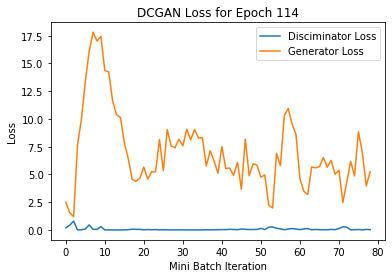

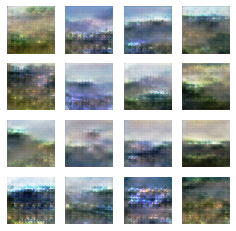

EPOCH 115 took 8.4 sec
Gen_loss mean= 8.201209 std= 4.699952
Disc_loss mean= 0.1311729 std= 0.32094294


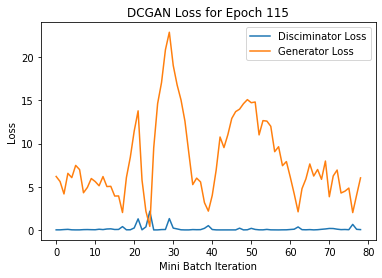

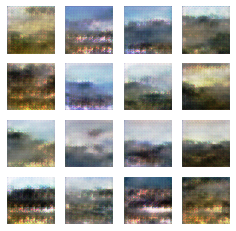

EPOCH 116 took 8.3 sec
Gen_loss mean= 7.4328837 std= 3.080153
Disc_loss mean= 0.11531339 std= 0.19790637


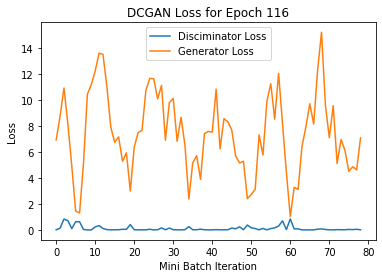

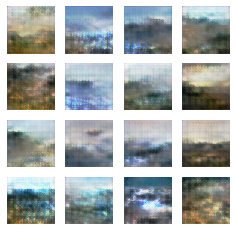

EPOCH 117 took 8.4 sec
Gen_loss mean= 8.111825 std= 3.98361
Disc_loss mean= 0.08567532 std= 0.13739422


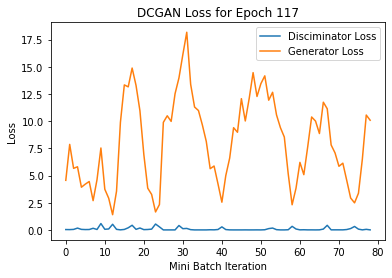

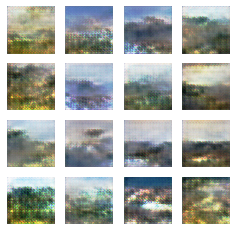

EPOCH 118 took 8.3 sec
Gen_loss mean= 7.844171 std= 3.4511921
Disc_loss mean= 0.0785453 std= 0.13632503


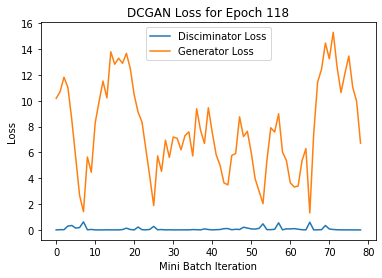

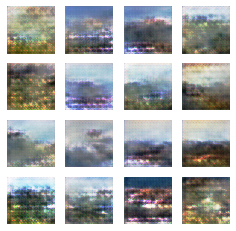

EPOCH 119 took 8.4 sec
Gen_loss mean= 6.6344304 std= 3.029991
Disc_loss mean= 0.09350388 std= 0.15736538


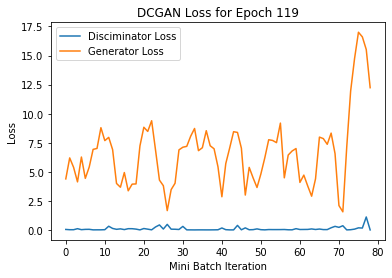

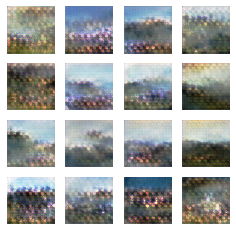

EPOCH 120 took 8.3 sec
Gen_loss mean= 8.023637 std= 4.3012824
Disc_loss mean= 0.08541556 std= 0.205455


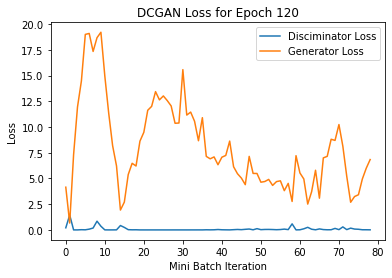

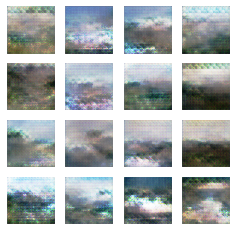

EPOCH 121 took 8.3 sec
Gen_loss mean= 6.7389636 std= 2.451985
Disc_loss mean= 0.066554256 std= 0.1084576


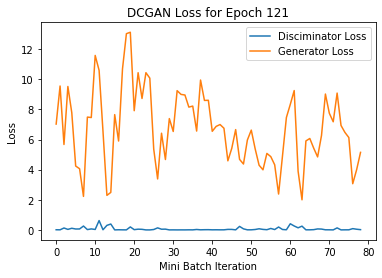

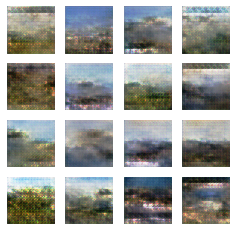

EPOCH 122 took 8.4 sec
Gen_loss mean= 7.7985654 std= 3.4547834
Disc_loss mean= 0.13443296 std= 0.35962334


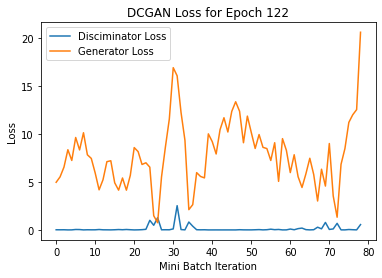

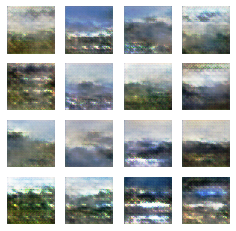

EPOCH 123 took 8.3 sec
Gen_loss mean= 8.447181 std= 4.8437176
Disc_loss mean= 0.21167941 std= 0.50544566


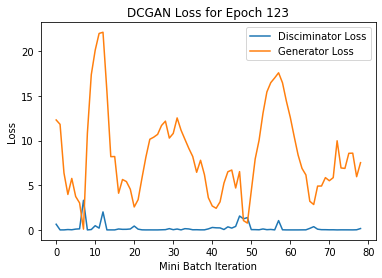

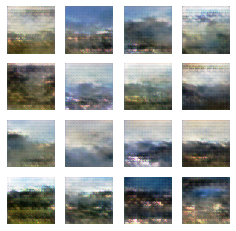

EPOCH 124 took 8.4 sec
Gen_loss mean= 5.064885 std= 1.5365176
Disc_loss mean= 0.08352777 std= 0.0834602


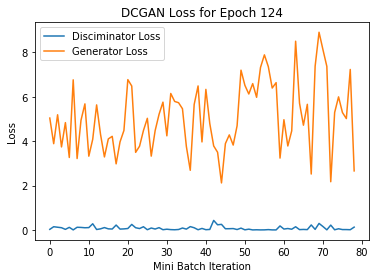

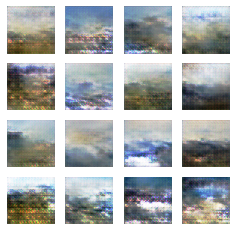

EPOCH 125 took 8.4 sec
Gen_loss mean= 6.258437 std= 2.3673923
Disc_loss mean= 0.09492626 std= 0.14952101


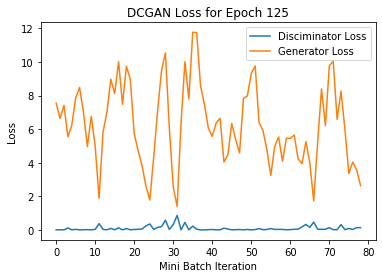

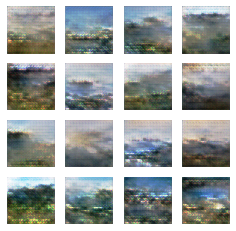

EPOCH 126 took 8.4 sec
Gen_loss mean= 7.376005 std= 2.7072423
Disc_loss mean= 0.047587655 std= 0.06999415


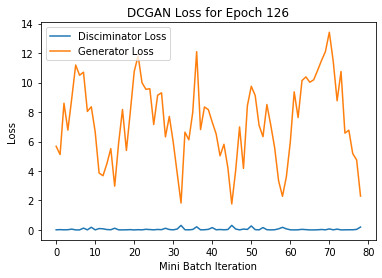

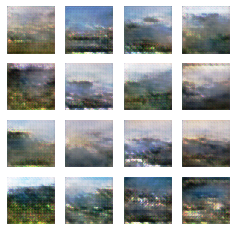

EPOCH 127 took 8.4 sec
Gen_loss mean= 7.0257545 std= 3.0097458
Disc_loss mean= 0.08011767 std= 0.13287558


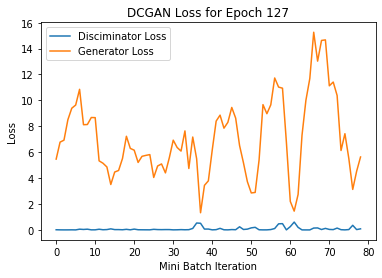

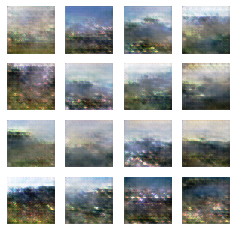

EPOCH 128 took 8.4 sec
Gen_loss mean= 6.297839 std= 2.1280956
Disc_loss mean= 0.06072236 std= 0.13783674


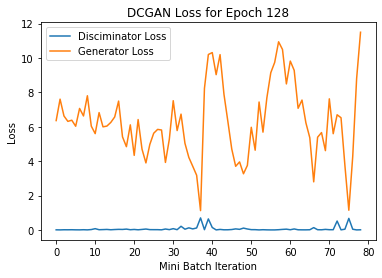

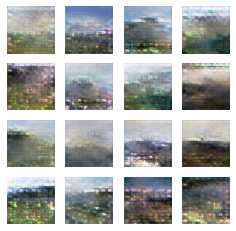

EPOCH 129 took 8.4 sec
Gen_loss mean= 8.577112 std= 4.106007
Disc_loss mean= 0.12331291 std= 0.26703027


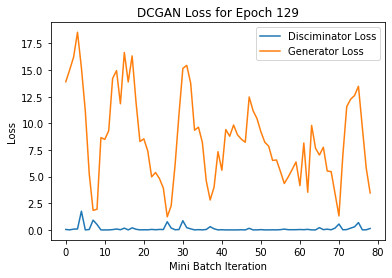

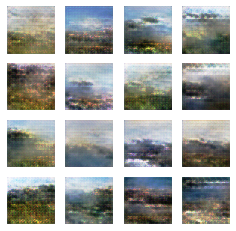

EPOCH 130 took 8.4 sec
Gen_loss mean= 8.068027 std= 3.7280512
Disc_loss mean= 0.049802143 std= 0.07863116


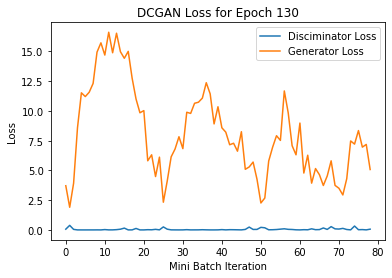

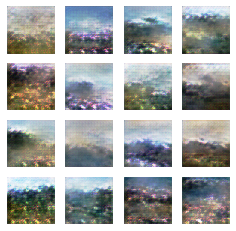

EPOCH 131 took 8.4 sec
Gen_loss mean= 7.8130927 std= 3.7957723
Disc_loss mean= 0.09046304 std= 0.18881685


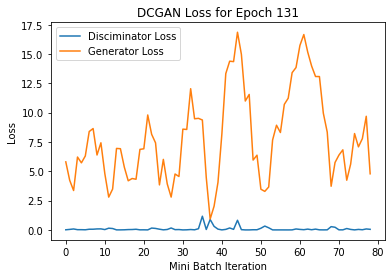

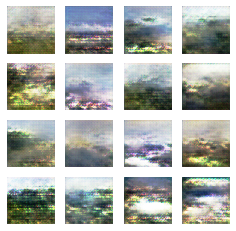

EPOCH 132 took 8.4 sec
Gen_loss mean= 6.6205244 std= 2.1242447
Disc_loss mean= 0.057138823 std= 0.10472697


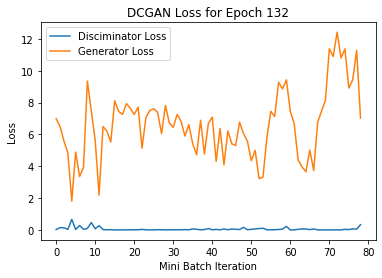

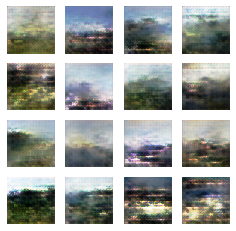

EPOCH 133 took 8.4 sec
Gen_loss mean= 7.1674857 std= 2.826604
Disc_loss mean= 0.06643454 std= 0.09606723


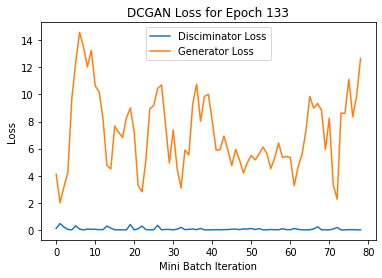

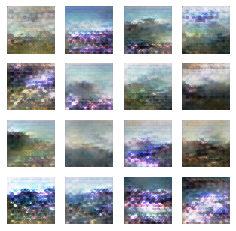

EPOCH 134 took 8.4 sec
Gen_loss mean= 7.7031164 std= 2.8968186
Disc_loss mean= 0.08577983 std= 0.20974384


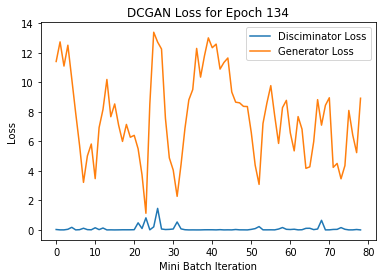

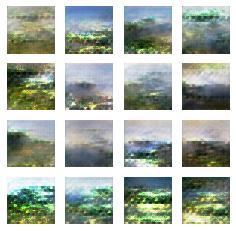

EPOCH 135 took 8.4 sec
Gen_loss mean= 7.7242403 std= 2.8974404
Disc_loss mean= 0.061789826 std= 0.12445899


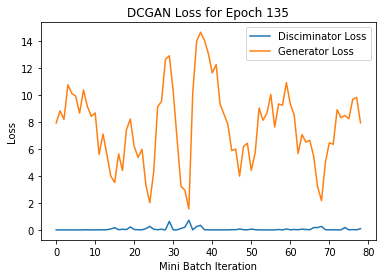

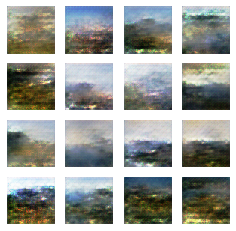

EPOCH 136 took 8.4 sec
Gen_loss mean= 7.2758303 std= 3.1082222
Disc_loss mean= 0.10102529 std= 0.26568076


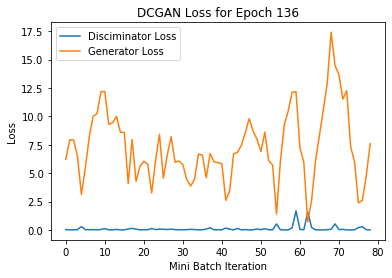

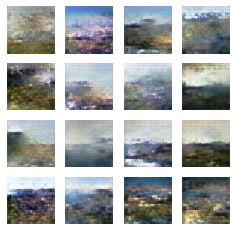

EPOCH 137 took 8.4 sec
Gen_loss mean= 8.462652 std= 3.412978
Disc_loss mean= 0.112516835 std= 0.2850134


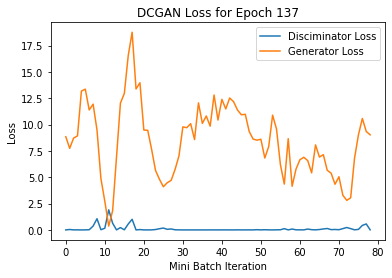

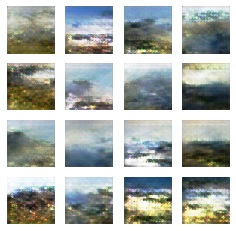

EPOCH 138 took 8.4 sec
Gen_loss mean= 6.4780927 std= 1.8473835
Disc_loss mean= 0.044931404 std= 0.07337126


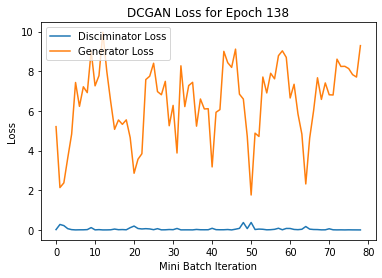

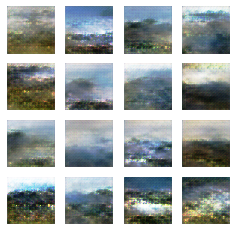

EPOCH 139 took 8.4 sec
Gen_loss mean= 6.0511465 std= 1.7599952
Disc_loss mean= 0.045123745 std= 0.06668905


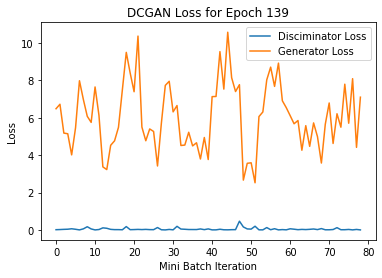

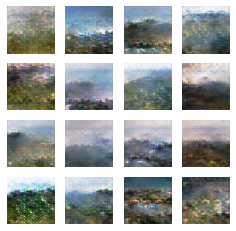

EPOCH 140 took 8.4 sec
Gen_loss mean= 7.4457335 std= 3.4477694
Disc_loss mean= 0.062009342 std= 0.099644914


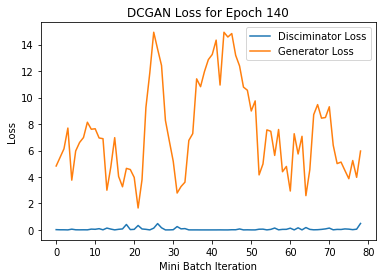

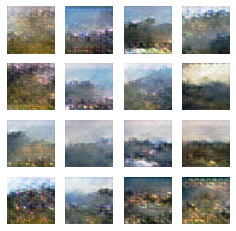

EPOCH 141 took 8.4 sec
Gen_loss mean= 7.1192064 std= 2.253485
Disc_loss mean= 0.04519455 std= 0.077690415


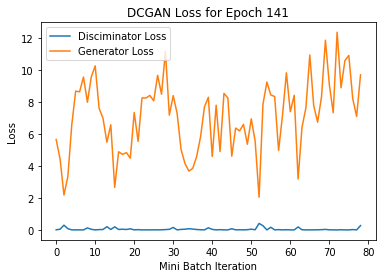

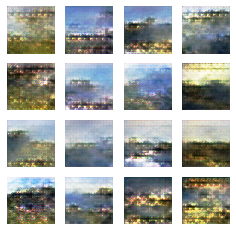

EPOCH 142 took 8.4 sec
Gen_loss mean= 7.4856906 std= 3.0929914
Disc_loss mean= 0.053989567 std= 0.10125073


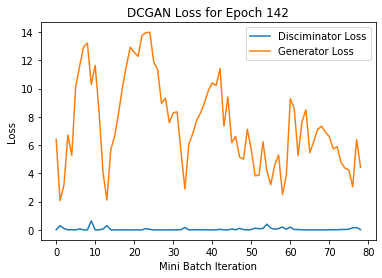

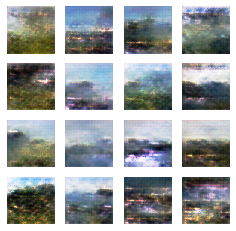

EPOCH 143 took 8.4 sec
Gen_loss mean= 8.1049385 std= 3.83787
Disc_loss mean= 0.08903858 std= 0.21272632


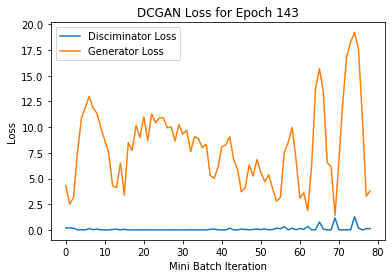

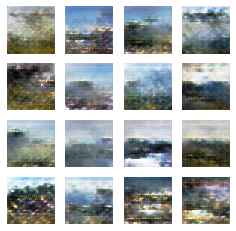

EPOCH 144 took 8.4 sec
Gen_loss mean= 7.379403 std= 2.6736207
Disc_loss mean= 0.080080055 std= 0.20298797


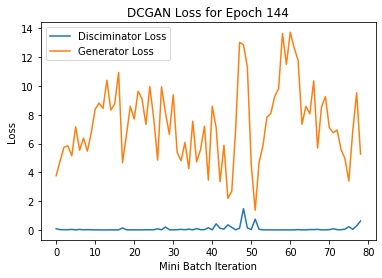

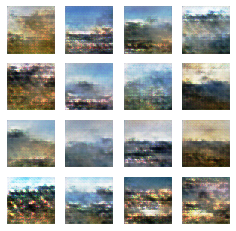

EPOCH 145 took 8.4 sec
Gen_loss mean= 8.161969 std= 4.2198606
Disc_loss mean= 0.1290848 std= 0.31532326


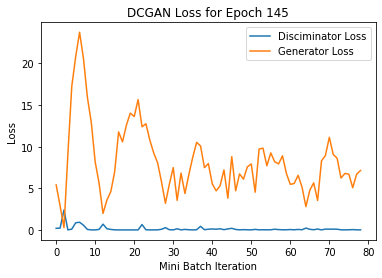

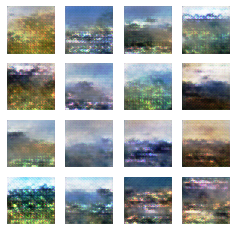

EPOCH 146 took 8.4 sec
Gen_loss mean= 7.3800893 std= 3.284805
Disc_loss mean= 0.10732312 std= 0.27674153


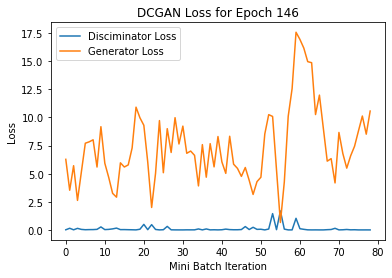

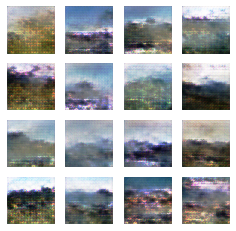

EPOCH 147 took 8.4 sec
Gen_loss mean= 6.9703116 std= 2.637016
Disc_loss mean= 0.09279191 std= 0.15769179


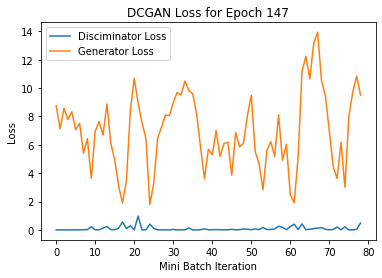

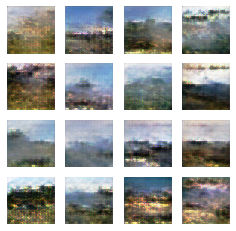

EPOCH 148 took 8.4 sec
Gen_loss mean= 7.041143 std= 2.3117278
Disc_loss mean= 0.04373964 std= 0.06849151


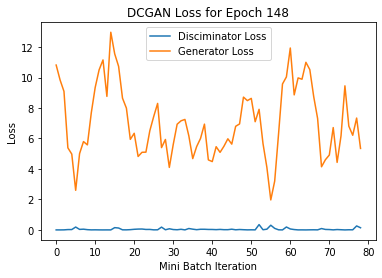

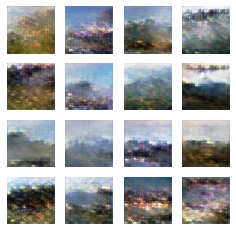

EPOCH 149 took 8.4 sec
Gen_loss mean= 7.5329814 std= 4.0637875
Disc_loss mean= 0.106257364 std= 0.2246765


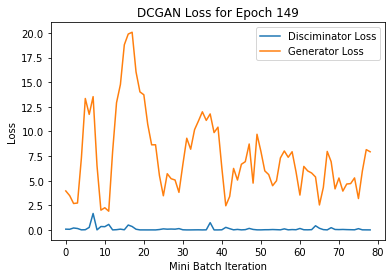

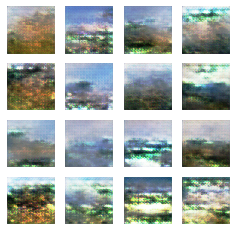

EPOCH 150 took 8.4 sec
Gen_loss mean= 7.5140977 std= 2.8285866
Disc_loss mean= 0.054676622 std= 0.10290865


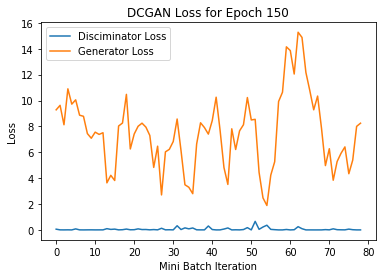

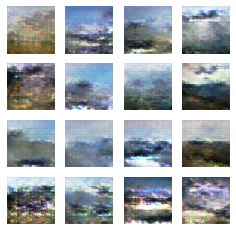

EPOCH 151 took 8.4 sec
Gen_loss mean= 7.3372283 std= 3.131326
Disc_loss mean= 0.086816356 std= 0.18045914


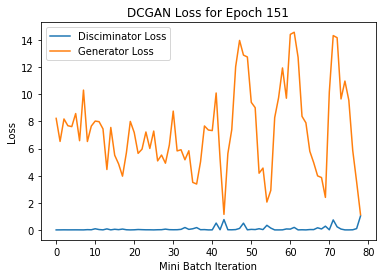

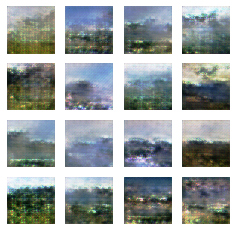

EPOCH 152 took 8.4 sec
Gen_loss mean= 7.344338 std= 3.3661804
Disc_loss mean= 0.087487206 std= 0.28612337


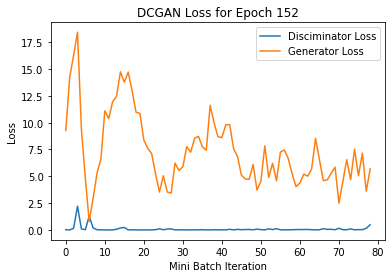

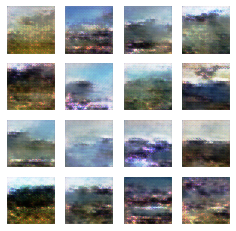

EPOCH 153 took 8.4 sec
Gen_loss mean= 8.216974 std= 3.6708257
Disc_loss mean= 0.09279188 std= 0.16993895


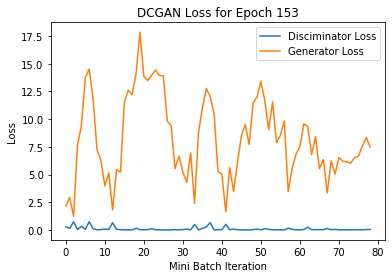

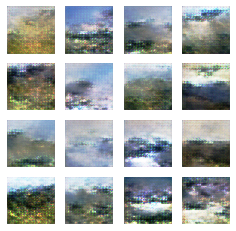

EPOCH 154 took 8.4 sec
Gen_loss mean= 6.4082723 std= 2.5617511
Disc_loss mean= 0.07790032 std= 0.17180385


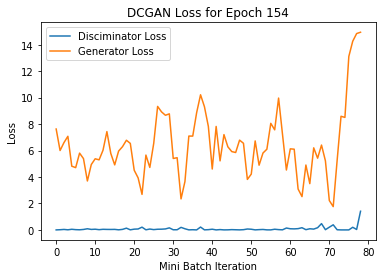

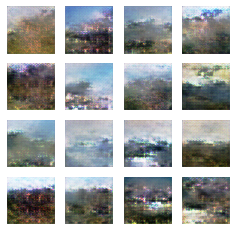

EPOCH 155 took 8.4 sec
Gen_loss mean= 7.9869294 std= 3.3388188
Disc_loss mean= 0.10186993 std= 0.19005182


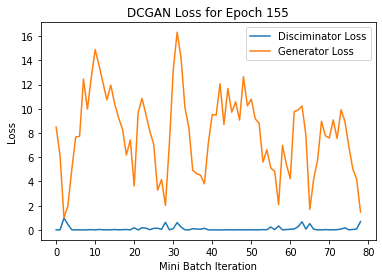

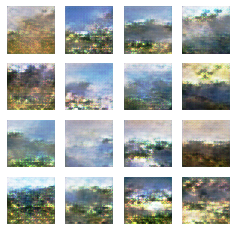

EPOCH 156 took 8.4 sec
Gen_loss mean= 8.284135 std= 3.6149614
Disc_loss mean= 0.110885754 std= 0.1938589


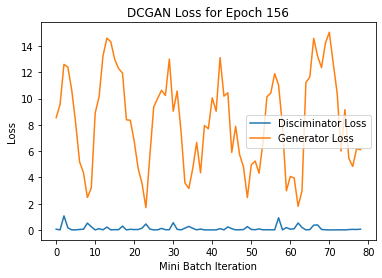

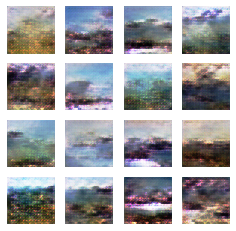

EPOCH 157 took 8.4 sec
Gen_loss mean= 7.0648355 std= 2.8484483
Disc_loss mean= 0.075961895 std= 0.119550735


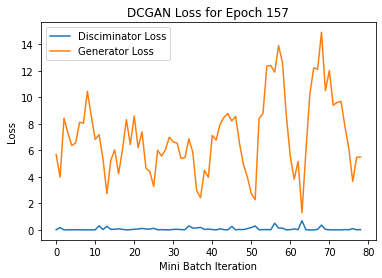

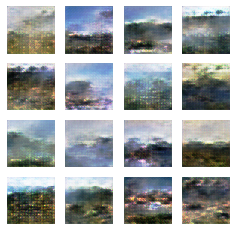

EPOCH 158 took 8.4 sec
Gen_loss mean= 6.2130246 std= 2.638193
Disc_loss mean= 0.08381311 std= 0.17895679


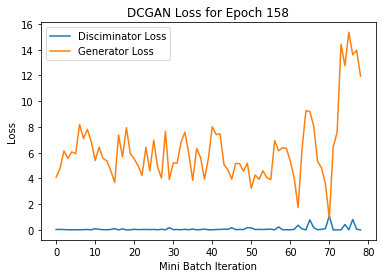

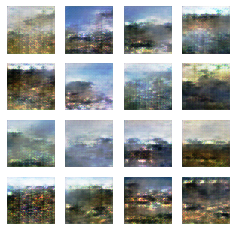

EPOCH 159 took 8.4 sec
Gen_loss mean= 7.123305 std= 2.607369
Disc_loss mean= 0.05264424 std= 0.08593137


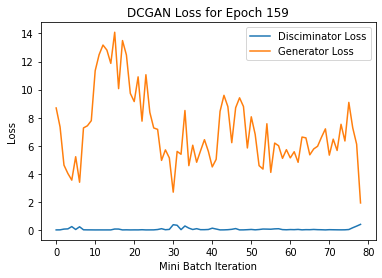

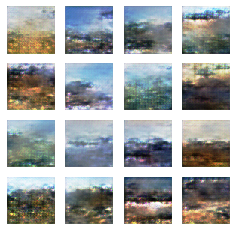

EPOCH 160 took 8.4 sec
Gen_loss mean= 7.0137706 std= 3.3048866
Disc_loss mean= 0.16357878 std= 0.65385306


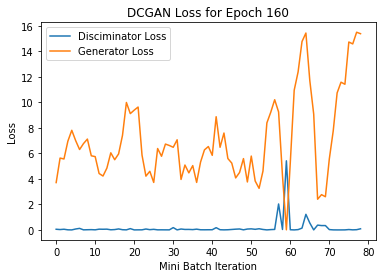

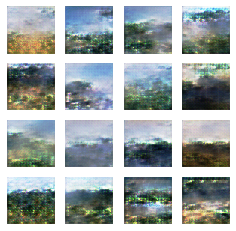

EPOCH 161 took 8.4 sec
Gen_loss mean= 8.150608 std= 3.9228349
Disc_loss mean= 0.1581448 std= 0.4065444


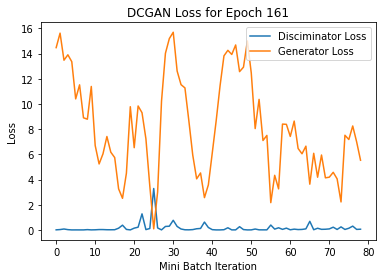

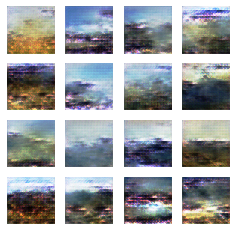

EPOCH 162 took 8.4 sec
Gen_loss mean= 6.1408606 std= 1.8885411
Disc_loss mean= 0.039848045 std= 0.05486883


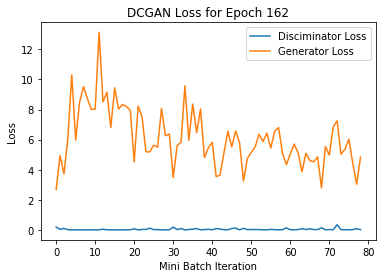

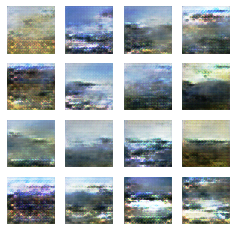

EPOCH 163 took 8.4 sec
Gen_loss mean= 6.1811495 std= 1.8629812
Disc_loss mean= 0.058793925 std= 0.21479553


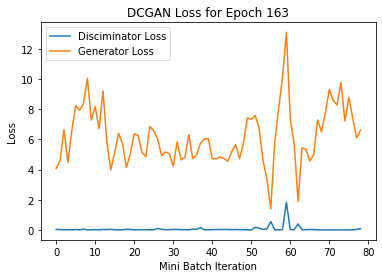

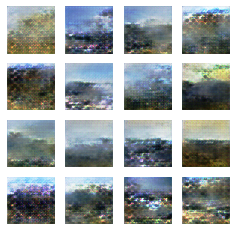

EPOCH 164 took 8.4 sec
Gen_loss mean= 6.3229356 std= 1.8390253
Disc_loss mean= 0.06388403 std= 0.18296844


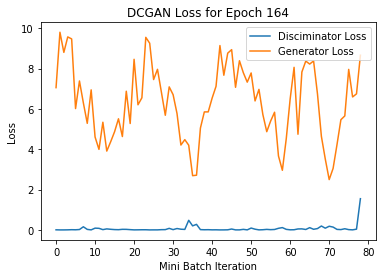

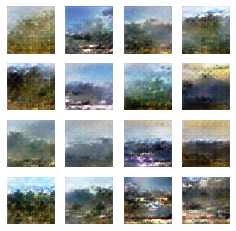

EPOCH 165 took 8.4 sec
Gen_loss mean= 8.083362 std= 3.5558028
Disc_loss mean= 0.08821498 std= 0.19785601


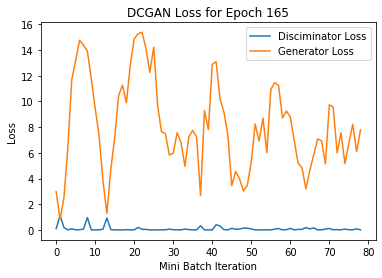

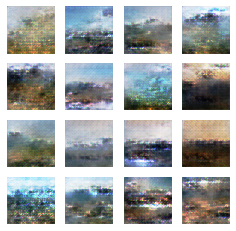

EPOCH 166 took 8.4 sec
Gen_loss mean= 6.824653 std= 2.5263777
Disc_loss mean= 0.07005579 std= 0.13611488


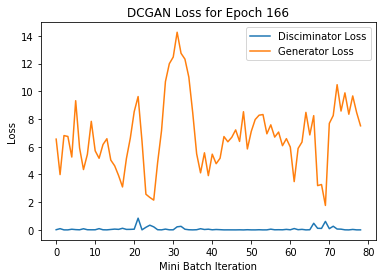

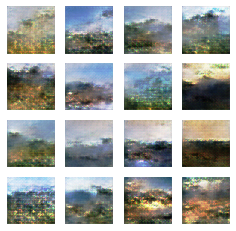

EPOCH 167 took 8.4 sec
Gen_loss mean= 6.3433566 std= 1.4500614
Disc_loss mean= 0.03425391 std= 0.04745566


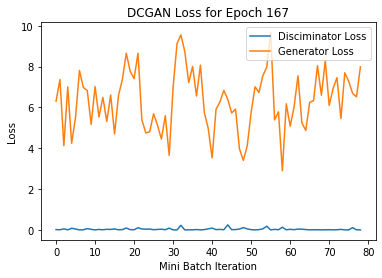

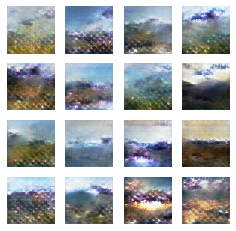

EPOCH 168 took 8.3 sec
Gen_loss mean= 10.070154 std= 5.1877365
Disc_loss mean= 0.18597656 std= 0.3782878


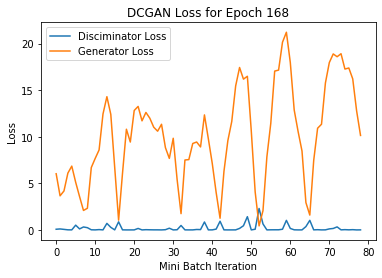

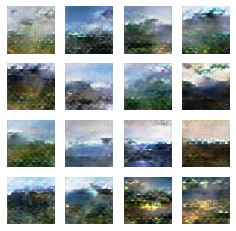

EPOCH 169 took 8.3 sec
Gen_loss mean= 8.800009 std= 3.9819486
Disc_loss mean= 0.12906787 std= 0.275285


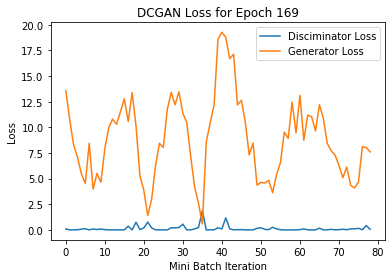

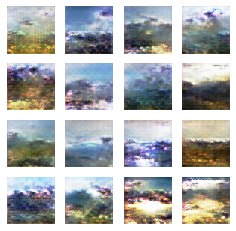

EPOCH 170 took 8.3 sec
Gen_loss mean= 7.171429 std= 3.098214
Disc_loss mean= 0.08194509 std= 0.1302938


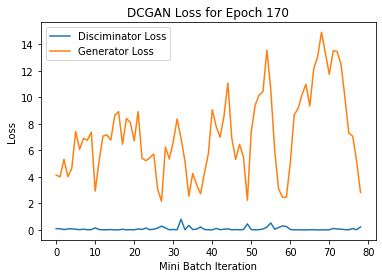

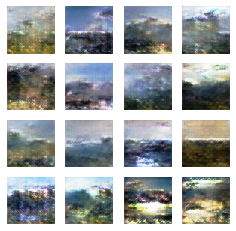

EPOCH 171 took 8.4 sec
Gen_loss mean= 7.650444 std= 2.9962194
Disc_loss mean= 0.0613436 std= 0.10347707


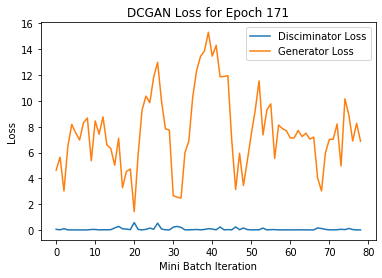

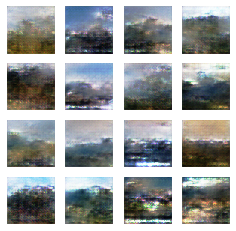

EPOCH 172 took 8.4 sec
Gen_loss mean= 6.2019925 std= 1.9185631
Disc_loss mean= 0.042747367 std= 0.062241256


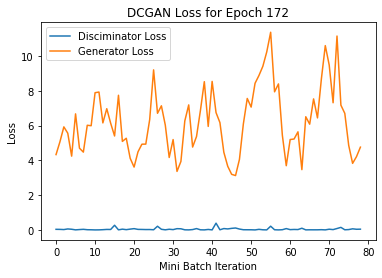

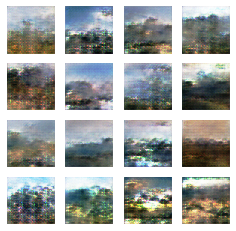

EPOCH 173 took 8.4 sec
Gen_loss mean= 8.474979 std= 4.1704903
Disc_loss mean= 0.22490233 std= 0.71174335


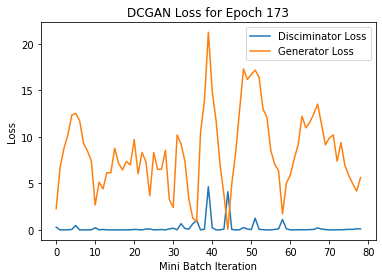

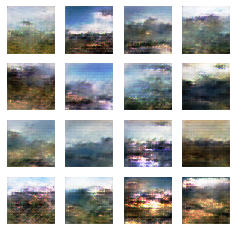

EPOCH 174 took 8.4 sec
Gen_loss mean= 6.458259 std= 2.552768
Disc_loss mean= 0.09094592 std= 0.1385369


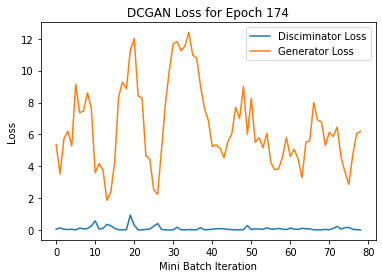

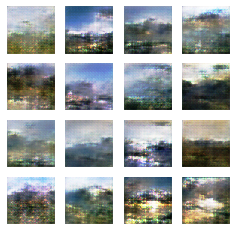

EPOCH 175 took 8.3 sec
Gen_loss mean= 6.965396 std= 2.7683127
Disc_loss mean= 0.07779802 std= 0.1184402


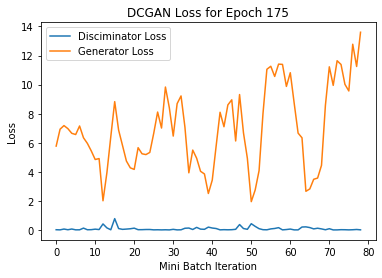

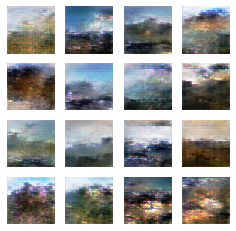

EPOCH 176 took 8.3 sec
Gen_loss mean= 6.722275 std= 2.2407353
Disc_loss mean= 0.07468302 std= 0.18885647


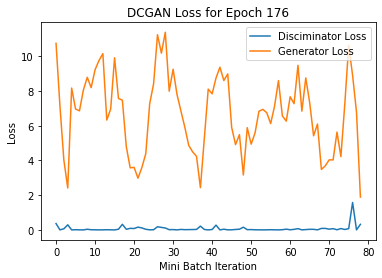

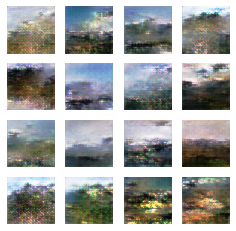

EPOCH 177 took 8.4 sec
Gen_loss mean= 8.015384 std= 3.6561637
Disc_loss mean= 0.08931273 std= 0.18180974


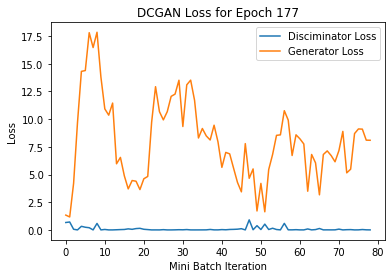

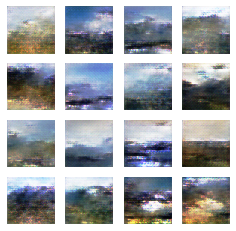

EPOCH 178 took 8.4 sec
Gen_loss mean= 7.3485208 std= 3.756552
Disc_loss mean= 0.17202505 std= 0.30110404


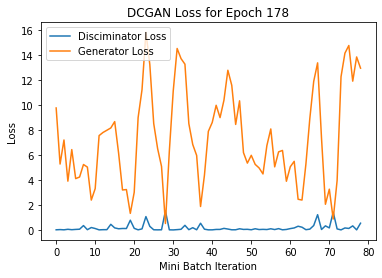

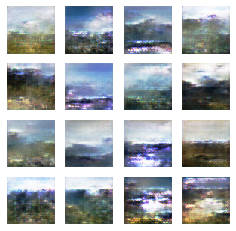

EPOCH 179 took 8.4 sec
Gen_loss mean= 6.4570107 std= 1.9321977
Disc_loss mean= 0.05107119 std= 0.071347415


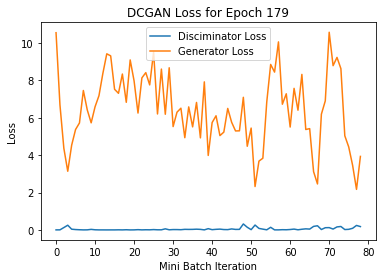

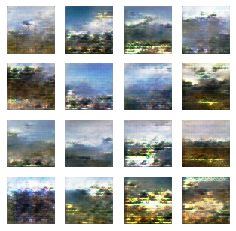

EPOCH 180 took 8.4 sec
Gen_loss mean= 9.872364 std= 4.0754647
Disc_loss mean= 0.07393328 std= 0.14389306


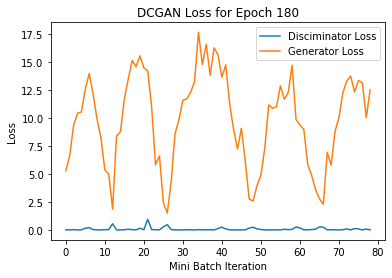

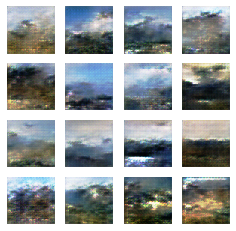

EPOCH 181 took 8.4 sec
Gen_loss mean= 6.7099347 std= 2.6796281
Disc_loss mean= 0.07310291 std= 0.15316768


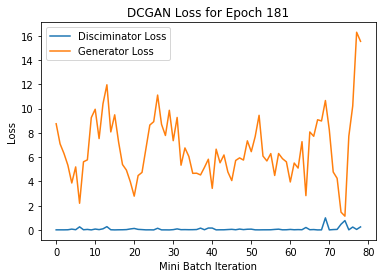

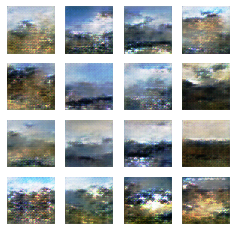

EPOCH 182 took 8.4 sec
Gen_loss mean= 8.09663 std= 3.6095362
Disc_loss mean= 0.07366837 std= 0.13059582


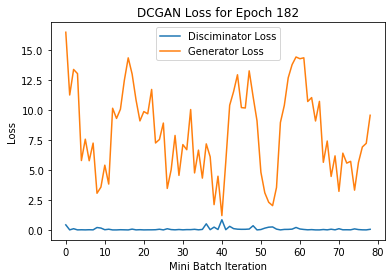

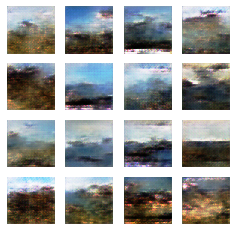

EPOCH 183 took 8.4 sec
Gen_loss mean= 7.0060973 std= 2.9567227
Disc_loss mean= 0.0984179 std= 0.22314738


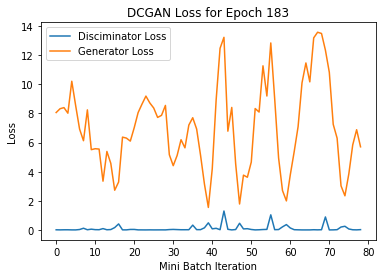

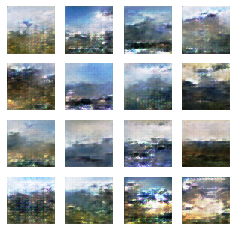

EPOCH 184 took 8.4 sec
Gen_loss mean= 6.544699 std= 1.9408741
Disc_loss mean= 0.04578359 std= 0.055134147


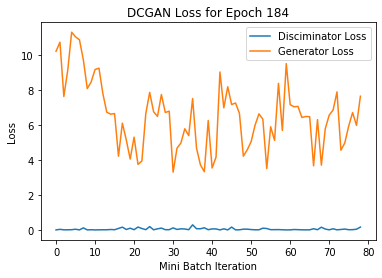

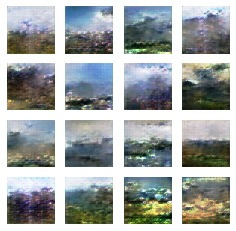

EPOCH 185 took 8.4 sec
Gen_loss mean= 5.9258966 std= 1.8143889
Disc_loss mean= 0.053223237 std= 0.069594316


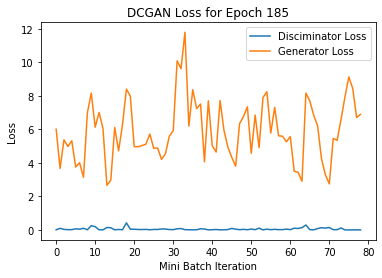

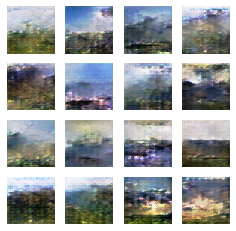

EPOCH 186 took 8.4 sec
Gen_loss mean= 9.648074 std= 4.980173
Disc_loss mean= 0.17806803 std= 0.33660522


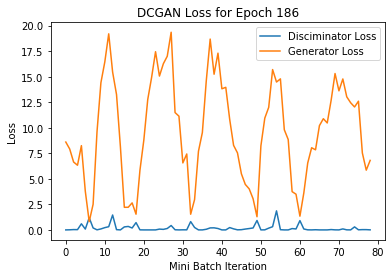

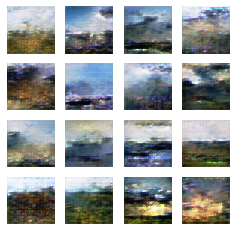

EPOCH 187 took 8.3 sec
Gen_loss mean= 6.431114 std= 1.9108754
Disc_loss mean= 0.062702395 std= 0.13698617


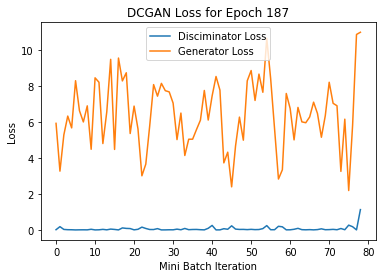

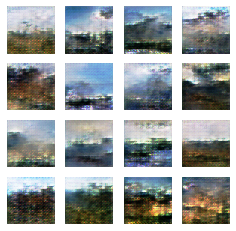

EPOCH 188 took 8.4 sec
Gen_loss mean= 7.516057 std= 2.8936055
Disc_loss mean= 0.056890003 std= 0.11550937


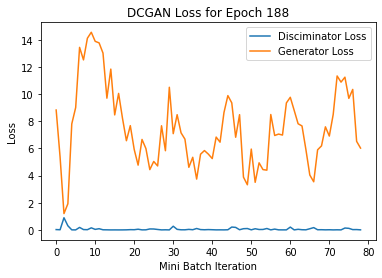

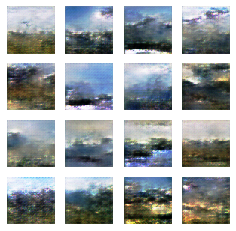

EPOCH 189 took 8.3 sec
Gen_loss mean= 6.842086 std= 2.5636551
Disc_loss mean= 0.06960399 std= 0.14580242


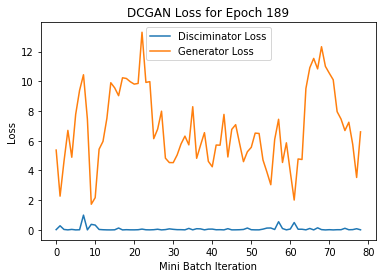

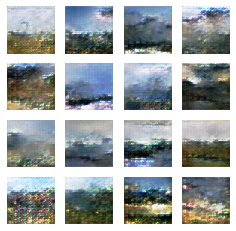

EPOCH 190 took 8.4 sec
Gen_loss mean= 6.647309 std= 2.4677916
Disc_loss mean= 0.08107658 std= 0.2053064


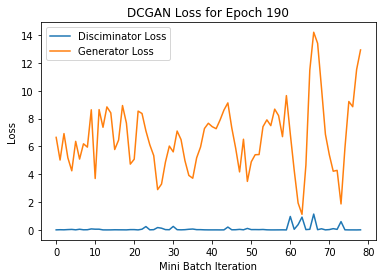

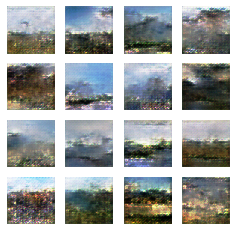

EPOCH 191 took 8.4 sec
Gen_loss mean= 7.978474 std= 3.363223
Disc_loss mean= 0.06738731 std= 0.13876468


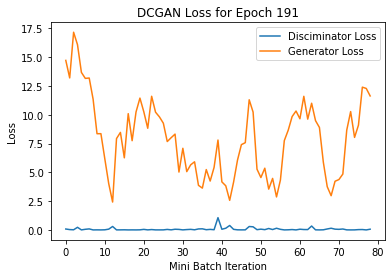

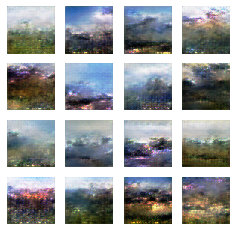

EPOCH 192 took 8.4 sec
Gen_loss mean= 7.6859193 std= 3.09652
Disc_loss mean= 0.12556678 std= 0.34088334


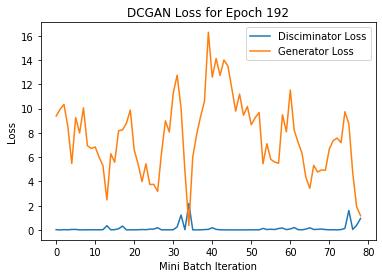

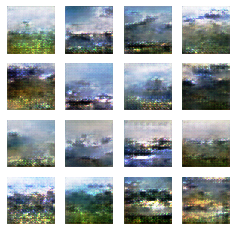

EPOCH 193 took 8.4 sec
Gen_loss mean= 7.5867686 std= 3.0184517
Disc_loss mean= 0.038318183 std= 0.045200124


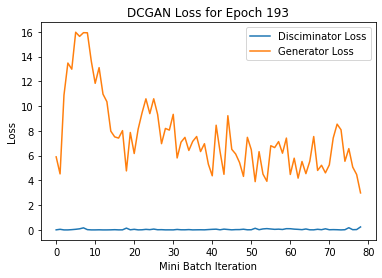

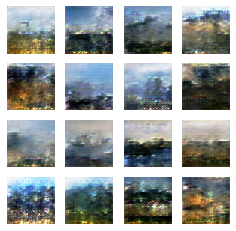

EPOCH 194 took 8.4 sec
Gen_loss mean= 7.3199286 std= 3.058757
Disc_loss mean= 0.07083724 std= 0.1333316


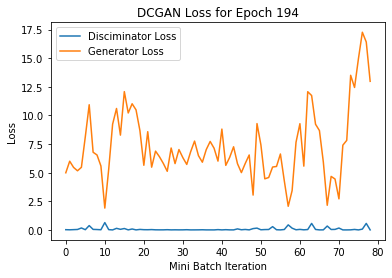

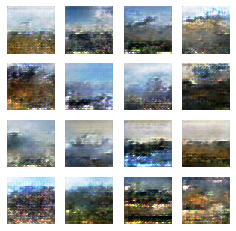

EPOCH 195 took 8.4 sec
Gen_loss mean= 7.495694 std= 3.4238641
Disc_loss mean= 0.05736957 std= 0.12420492


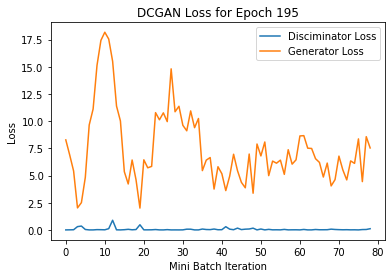

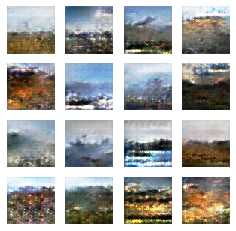

EPOCH 196 took 8.4 sec
Gen_loss mean= 7.7908435 std= 3.1664164
Disc_loss mean= 0.07867488 std= 0.13814041


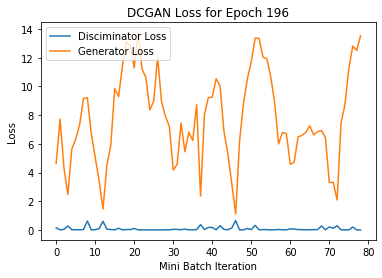

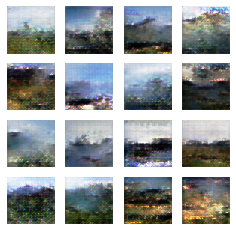

EPOCH 197 took 8.4 sec
Gen_loss mean= 6.8406177 std= 2.6904895
Disc_loss mean= 0.06681794 std= 0.13081795


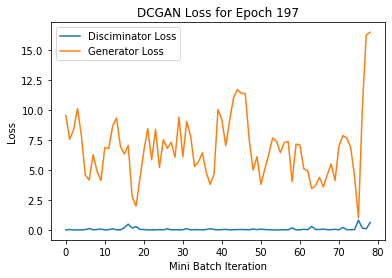

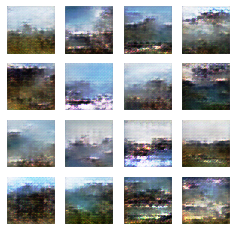

EPOCH 198 took 8.4 sec
Gen_loss mean= 7.002776 std= 2.5600643
Disc_loss mean= 0.10291637 std= 0.29871404


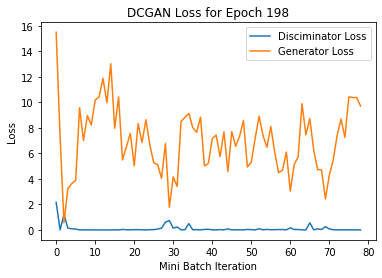

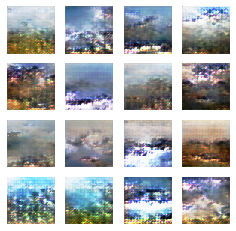

EPOCH 199 took 8.4 sec
Gen_loss mean= 8.294421 std= 3.864301
Disc_loss mean= 0.13045126 std= 0.35549465


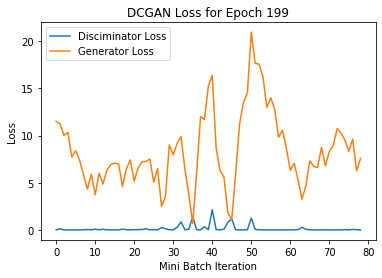

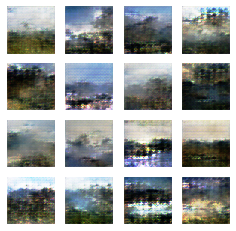

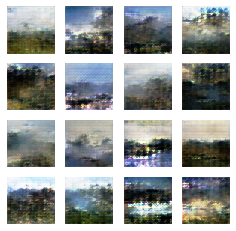

In [43]:
train(train_dataset, EPOCHS)

In [44]:
generator.save_weights('manually_saved_weights/generator/200_epochs')
discriminator.save_weights('manually_saved_weights/discriminator/200_epochs')

In [45]:
tf.saved_model.save(generator, "saved_model/1/generator")
tf.saved_model.save(discriminator, "saved_model/1/discriminator")

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: saved_model/1/generator/assets
INFO:tensorflow:Assets written to: saved_model/1/discriminator/assets
